# Capstone Project Part 4: Classification and Prediction Models

## Importing Libraries

In [ ]:
import pandas as pd
from bs4 import BeautifulSoup
import requests
from pprint import pprint
import matplotlib.pyplot as plt
from pandas_summary import DataFrameSummary
import seaborn as sns
import numpy as np
from collections import Counter
import operator
plt.style.use('ggplot')
%config InlineBackend.figure_format = 'retina'
%matplotlib inline
import matplotlib.pyplot as plt


from sklearn.linear_model import LinearRegression,LogisticRegression, RidgeCV, LassoCV, Ridge, Lasso
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.model_selection import cross_val_score, cross_val_predict, KFold, train_test_split
from sklearn.metrics import mean_squared_error, accuracy_score
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor, ExtraTreesClassifier
from nltk.stem import WordNetLemmatizer
from sklearn.svm import SVR, LinearSVR
from sklearn.neural_network import MLPRegressor
from sklearn.pipeline import Pipeline
from sklearn.feature_selection import VarianceThreshold 
from sklearn.neighbors.classification import KNeighborsClassifier
from sklearn.multioutput import ClassifierChain
from sklearn.metrics import hamming_loss, zero_one_loss
from skmultilearn.problem_transform import BinaryRelevance, ClassifierChain, LabelPowerset
from skmultilearn.adapt import MLkNN
from textblob import TextBlob
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix, precision_score, roc_auc_score
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.metrics import average_precision_score
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import precision_score, recall_score, classification_report, mean_squared_error, roc_curve, auc

from sklearn.externals.six import StringIO
from sklearn.tree import export_graphviz
import pydotplus
from IPython.display import Image

from sklearn.metrics import precision_recall_curve

# from PIL import Image
import matplotlib as mpl
from wordcloud import WordCloud
import matplotlib.colors as colors
from sklearn.metrics import jaccard_similarity_score


In [2]:
# loading the dataset
df = pd.read_csv('part_3_with_occ_gend_top.csv')
pd.set_option('display.max_columns',None)
pd.set_option('display.max_rows',None)

In [3]:
# removing the unnamed column added when the dataframe was saved as csv at the previous section of the project
df = df[list(df.columns)[1:]]

In [4]:
df.head()

,comments,description,duration,event,film_date,languages,main_speaker,name,published_date,ratings,speaker_occupation,tags,title,url,views,music,conversation,transcript,persuasive,inspiring,unconvincing,applause,laughter,norm_persuasive,norm_inspiring,norm_unconvincing,WC,Analytic,Clout,Authentic,Tone,WPS,Sixltr,Dic,function,pronoun,ppron,i,we,you,shehe,they,ipron,article,prep,auxverb,adverb,conj,negate,verb,adj,compare,interrog,number,quant,affect,posemo,negemo,anx,anger,sad,social,family,friend,female,male,cogproc,insight,cause,discrep,tentat,certain,differ,percept,see,hear,feel,bio,body,health,sexual,ingest,drives,affiliation,achieve,power,reward,risk,focuspast,focuspresent,focusfuture,relativ,motion,space,time,work,leisure,home,money,relig,death,informal,swear,netspeak,assent,nonflu,filler,AllPunc,Period,Comma,Colon,SemiC,QMark,Exclam,Dash,Quote,Apostro,Parenth,OtherP,Moral,HarmVirtue,HarmVice,FairnessVirtue,FairnessVice,IngroupVirtue,IngroupVice,AuthorityVirtue,AuthorityVice,PurityVirtue,PurityVice,MoralityGeneral,published_year,Harm,Fairness,Purity,Ingroup,Authority,fname,gender,technology_th,society_th,policy_politics_th,security_th,science_and_research_th,nature_environment_th,living_spaces_cult_th,religions_spirituality_th,tedmem_awardwin_th,emotions_psychology_th,business_th,entertainment_th,media_th,music_th,health_and_medicine_th,art_and_design_th,gender_matters_th,educ_learn_youth_th,sports,literature_th,human_th,continents_cities_countries_th,updated_occupations
0,4553,Sir Ken Robinson makes an entertaining and pro...,1164,TED2006,1140825600,60,Ken Robinson,Ken Robinson: Do schools kill creativity?,1151367060,"[{'id': 7, 'name': 'Funny', 'count': 19645}, {...",Author/educator,"['children', 'creativity', 'culture', 'dance',...",Do schools kill creativity?,https://www.ted.com/talks/ken_robinson_says_sc...,47227110,0,0,"Good morning. How are you?()It's been great, h...",10704,24924,300,4,39,226.649482,527.747728,6.352284,3119,38.67,90.77,30.78,56.66,15.07,14.84,91.50,59.70,18.98,12.28,2.50,2.56,2.60,2.76,1.86,6.70,7.57,13.02,12.02,5.13,6.70,2.28,20.94,3.30,1.54,2.12,1.67,1.83,3.78,2.66,1.03,0.35,0.10,0.10,16.45,0.45,0.03,2.47,1.31,11.99,2.82,1.76,2.08,2.15,1.64,3.56,2.79,0.80,1.76,0.13,1.67,0.74,0.45,0.03,0.35,8.27,3.33,1.12,2.98,0.83,0.45,6.25,12.98,1.15,13.95,2.44,7.60,3.94,3.27,1.44,0.42,0.10,0.13,0.00,0.22,0.00,0.00,0.06,0.06,0.10,26.42,7.18,7.69,0.13,0.35,1.25,0.06,0.48,2.24,4.26,2.76,0.00,0.99,0.00,0.00,0.00,0.00,0.03,0.00,0.41,0.00,0.00,0.03,0.51,2006,0.00,0.00,0.03,0.03,0.41,Ken,male,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,1,0,Educator
1,265,With the same humor and humanity he exuded in ...,977,TED2006,1140825600,43,Al Gore,Al Gore: Averting the climate crisis,1151367060,"[{'id': 7, 'name': 'Funny', 'count': 544}, {'i...",Climate advocate,"['alternative energy', 'cars', 'climate change...",Averting the climate crisis,https://www.ted.com/talks/al_gore_on_averting_...,3200520,0,0,"Thank you so much, Chris. And it's truly a gre...",268,413,258,3,21,83.736393,129.041531,80.611901,723,76.53,75.55,70.35,51.66,30.12,12.59,86.86,55.33,16.74,11.48,6.09,2.35,1.11,1.38,0.55,5.26,8.02,15.77,7.33,4.15,5.53,0.41,17.29,4.01,1.80,1.11,1.52,2.49,3.87,2.63,1.24,0.28,0.14,0.55,10.93,0.69,0.41,0.97,1.11,5.95,0.97,0.97,0.83,0.83,1.52,0.97,3.46,0.83,2.49,0.14,1.80,0.28,0.28,0.00,1.24,8.02,3.73,0.69,2.35,1.66,0.14,9.68,5.95,1.11,18.40,2.77,10.51,5.67,1.24,1.52,1.11,0.69,0.00,0.00,0.14,0.00,0.00,0.14,0.00,0.00,27.11,5.12,7.47,0.28,0.14,0.41,0.69,0.83,2.07,2.90,7.19,0.00,1.10,0.00,0.00,0.00,0.00,0.55,0.00,0.41,0.00,0.00,0.00,0.14,2006,0.00,0.00,0.00,0.55,0.41,Al,male,1,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,Activist
2,124,New York Times columnist David Pogue takes aim...,1286,TED2006,1140739200,26,David Pogue,David Pogue: Simplicity sells,1151367060,"[{'id': 7, 'name': 'Funny', 'count': 964}, {'i...",Technology columnist,"['computers', 'entertainment', 'interface desi...",Simplicity sells,https://www.ted.com/talks/david_pogue_says

## Prediction Models for Number of Views

In this section, I'll be using multiple models to predict the number of views that each TED Talk video got using a number of different variables.

### Preparing Predictor Variables

#### Gender Column

In [12]:
# Binarizing thge gender column: 0 - female, 1 - male
df.gender = df.gender.map(lambda x:1 if x == 'male' else 0)

In [13]:
df.gender.head()

0    1
1    1
2    1
3    0
4    1
Name: gender, dtype: int64

#### Updated Occupations Column

As part of the EDA of my project, I grouped the very specific occupation titles in more generalized groups (see part 2 - EDA notebook for details). Below titles are examples of these generalized groups.

In [14]:
df.updated_occupations.head()

0    Educator
1    Activist
2      Writer
3    Activist
4      Expert
Name: updated_occupations, dtype: object

In [15]:
# dummifying the occupations
dummy_occ = pd.get_dummies(df['updated_occupations'],prefix='occ')
df = pd.concat([df, dummy_occ], axis = 1)

I didn't drop the first dummified column in the above function as I will be removing the 'other' category as it has more data points than the other more meaningful occupation groups in this dataset.

In [16]:
# checking to see if all the dummified column names are formatted correctly.
list(df.columns)[139:]

['technology_th',
 'society_th',
 'policy_politics_th',
 'security_th',
 'science_and_research_th',
 'nature_environment_th',
 'living_spaces_cult_th',
 'religions_spirituality_th',
 'tedmem_awardwin_th',
 'emotions_psychology_th',
 'business_th',
 'entertainment_th',
 'media_th',
 'music_th',
 'health_and_medicine_th',
 'art_and_design_th',
 'gender_matters_th',
 'educ_learn_youth_th',
 'sports',
 'literature_th',
 'human_th',
 'continents_cities_countries_th',
 'updated_occupations',
 'occ_Activist',
 'occ_Anthropologist',
 'occ_Archaeologist',
 'occ_Architect',
 'occ_Artist',
 'occ_Astronomer',
 'occ_Athlete',
 'occ_Author',
 'occ_Biologist',
 'occ_Blogger',
 'occ_CEO',
 'occ_Chef',
 'occ_Chemist',
 'occ_Comedian',
 'occ_Consultant',
 'occ_Curator',
 'occ_Designer',
 'occ_Doctor',
 'occ_Ecologist',
 'occ_Economist',
 'occ_Editor',
 'occ_Educator',
 'occ_Engineer',
 'occ_Entrepreneur',
 'occ_Expert',
 'occ_Filmmaker',
 'occ_Founder',
 'occ_Futurist',
 'occ_Geneticist',
 'occ_Governme

In [17]:
# renaming the column names that includes spaces.
df = df.rename(columns= {'occ_No Occupation Noted':'occ_No_Occupation_Noted', 
                         'occ_Venture capitalist':'occ_Venture_capitalist',
                        'occ_Government Official': 'occ_Government_Official',
                        'occ_Spiritual leader': 'occ_Spiritual_leader',
                        'occ_Media exec': 'occ_Media_exec',})

#### Eliminating the Continuous Predictor Variables with High Correlations

LIWC and Morality Foundations features in this dataset includes some main and sub items that are directly related to each other. As these could decrease the performance of the predictive models, I removed the highly correlated features from the predictor matrix.

For more details about the Linguistic features, please see the data dictionary in Part 1: Data Cleaning notebook.

In [18]:
corr = df.corr()
# filtering the correlations higher than 0.7
high_corr = corr[(1> corr) & (corr > 0.7)].stack().reset_index()
high_corr.columns = ['Var1', 'Var2', 'correlation']
high_corr.sort_values(by=['correlation'], ascending=False).drop_duplicates(subset='correlation', keep='last')

,Var1,Var2,correlation
58,published_year,published_date,0.995832
55,AuthorityVirtue,Authority,0.986240
1,film_date,published_date,0.936109
54,IngroupVirtue,Ingroup,0.934285
57,published_year,film_date,0.930754
0,duration,WC,0.906017
56,PurityVice,Purity,0.891969
42,affiliation,we,0.861767
52,FairnessVirtue,Fairness,0.850141
19,ppron,pronoun,0.823897


Removed features are:
* Published year & Published date
* Authority Virtue & Authority Vice 
* Ingroup Virtue & Ingroup Vice 
* Duration 
* Purity Vice & Purity Virtue 
* Fairness Vice & Virtue 
* We
* Affiliation
* ppron
* pronoun
* assent
* informal
* male
* affect
* HarmVirtue & HarmVice 
* relativ 
* health 
* nonflu 
* auxverb 
* see


### Removing Extreme Continuous Outliers

As my models performed poorly with the extreme outliers in my trials, I decided to remove the extreme ones (out of +/- 5SD range) and continue with my analyses with the reduced sample. There will still be some outliers remained in my features using with this range, but I removing the rest reduces my sample size considerably and in turn decreases the model performance.

In [227]:
var_list = ['comments', 'film_date', 'languages','music',
         'conversation','norm_persuasive','norm_inspiring','norm_unconvincing', 'WC','Analytic',
         'Clout','Authentic','Tone','WPS','Sixltr','Dic','function','i','you','shehe','they','ipron',
         'article','prep','auxverb','adverb','conj','negate','verb','adj','compare','interrog','number',
        'quant','posemo','negemo','anx','anger','sad','social','family','friend','female','cogproc',
        'insight','cause','discrep','tentat','certain','differ','percept','hear','feel','bio','body',
        'health','sexual','ingest','drives','achieve','power','reward','risk','focuspast','focuspresent',
        'focusfuture','motion','space','time','work','leisure','home','money','relig','death','informal',
        'swear','netspeak','filler','AllPunc','Period','Comma','Colon','SemiC','QMark','Exclam','Dash','Quote',
        'Apostro','Parenth','OtherP','Moral','MoralityGeneral','Harm','Fairness','Purity','Ingroup','Authority',
        'gender']

In [20]:
# function to drop the outliers
def drop_outliers(df, var_list):
    for var in var_list:
        mask = ((df[var] < ((df[var].mean() - (5)*(df[var].std())))) |
            (df[var] > ((df[var].mean() + (5)*(df[var].std())))))
        df = df[~mask]
    return df
    
df_= drop_outliers(df, var_list)
df_.shape

(1846, 304)

### Dependent and Independent Variables

In [228]:
# Final predictor matrix
X = df_[['film_date', 'languages','music',
         'conversation','norm_persuasive','norm_inspiring','norm_unconvincing', 'WC','Analytic',
         'Clout','Authentic','Tone','WPS','Sixltr','Dic','function','i','you','shehe','they','ipron',
         'article','prep','auxverb','adverb','conj','negate','verb','adj','compare','interrog','number',
        'quant','posemo','negemo','anx','anger','sad','social','family','friend','female','cogproc',
        'insight','cause','discrep','tentat','certain','differ','percept','hear','feel','bio','body',
        'health','sexual','ingest','drives','achieve','power','reward','risk','focuspast','focuspresent',
        'focusfuture','motion','space','time','work','leisure','home','money','relig','death','informal',
        'swear','netspeak','filler','AllPunc','Period','Comma','Colon','SemiC','QMark','Exclam','Dash','Quote',
        'Apostro','Parenth','OtherP','Moral','MoralityGeneral','Harm','Fairness','Purity','Ingroup','Authority',
        'gender']]

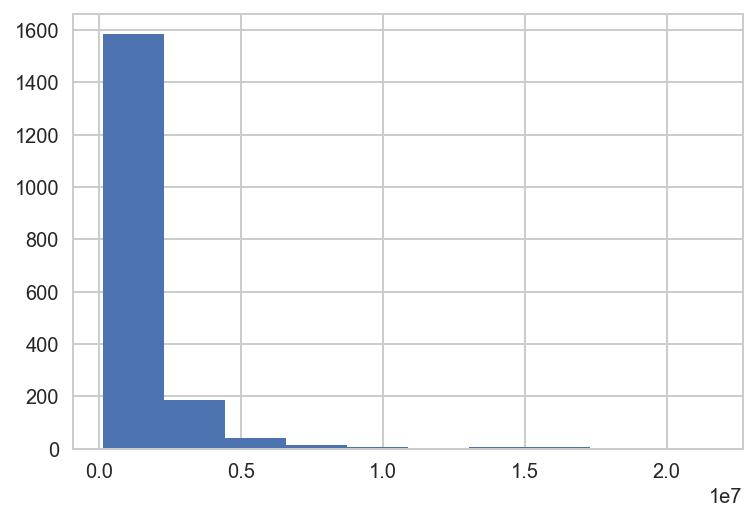

In [229]:
# Outcome variable
sns.set(style="whitegrid", color_codes=True, font_scale=1)
fig, ax = plt.subplots(figsize=(6,4))
plt.hist(df_.views);

In [230]:
# Centering the Outcome Variable with a Log transformation as it is highly skewed
y = df_.views.map(np.log)

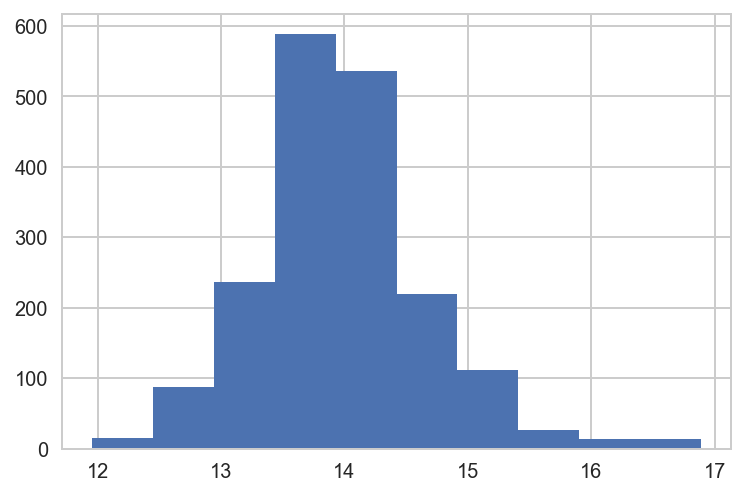

In [231]:
sns.set(style="whitegrid", color_codes=True, font_scale=1)
fig, ax = plt.subplots(figsize=(6,4))
plt.hist(y);

In [232]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 1, shuffle=True)

### Analyses with Random Forest, LinearSVR, MLP and Linear Regression Models

#### Pipelines for Random Forest, LinearSVR & MLP

Below are the pipelines generated for the models to predict number of views and the model parameters to be tuned with Grid Search. Analyses with each of these pipelines can be found in the next three sections.

In order to scale the predictor variables, Robust Scaler will be used as it performs better with the outliers than Standard Scaler. According to the description on scikit-learn manual, Robust Scaler 'removes the median and scales the data according to the quantile range (defaults to IQR: Interquartile Range). The IQR is the range between the 1st quartile (25th quantile) and the 3rd quartile (75th quantile)'.

In [37]:
# Random Forest Regressor Pipeline and parameters
pipeline_RF = Pipeline([
    ('rfm', RandomForestRegressor()),
])
parameters_RF = {"rfm__max_depth": [3, 6, 10, 15, None],
              "rfm__max_features": ['sqrt', 'log2', None, 0.2, 0.5, 0.7],
              "rfm__min_samples_split": [2, 3, 10, 15, 20, 50, 100],
              "rfm__min_samples_leaf": [1, 3, 10, 15, 20, 50, 100],
              "rfm__bootstrap": [True, False],
                'rfm__n_estimators':[30]}

# SVR Pipeline and parameters
pipeline_LSVR = Pipeline([
    ('ss', RobustScaler()),
    ('lsvr', LinearSVR())
])
parameters_LSVR = {
'lsvr__C': np.logspace(-3, 1, 50),
'lsvr__loss': ('epsilon_insensitive', 'squared_epsilon_insensitive')}

# MLP Regressor pipeline and parameters
pipeline_MLP = Pipeline([
    ('rs', RobustScaler()),
    ('mlp', MLPRegressor(random_state=1, max_iter=800)),
])
parameters_MLP ={'mlp__hidden_layer_sizes':((50,), (75,), (100,), (150,), (200,)),
                 'mlp__solver':('sgd', 'adam'),
                 'mlp__activation':('relu', 'identity'),
                 'mlp__alpha':np.logspace(-3, 1, 10) }


#### Random Forest Pipeline

In [59]:
# Fitting training data and tuning model parameters with a grid search.
gs = GridSearchCV(pipeline_RF, param_grid = parameters_RF , cv=3, n_jobs=-1, verbose=1)
gs.fit(X_train, y_train)

Fitting 3 folds for each of 2940 candidates, totalling 8820 fits


[Parallel(n_jobs=-1)]: Done  76 tasks      | elapsed:    1.9s
[Parallel(n_jobs=-1)]: Done 367 tasks      | elapsed:   15.2s
[Parallel(n_jobs=-1)]: Done 617 tasks      | elapsed:   32.6s
[Parallel(n_jobs=-1)]: Done 967 tasks      | elapsed:   54.7s
[Parallel(n_jobs=-1)]: Done 1437 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 2065 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done 2847 tasks      | elapsed:  3.3min
[Parallel(n_jobs=-1)]: Done 3664 tasks      | elapsed:  4.6min
[Parallel(n_jobs=-1)]: Done 4639 tasks      | elapsed:  5.8min
[Parallel(n_jobs=-1)]: Done 5656 tasks      | elapsed:  7.4min
[Parallel(n_jobs=-1)]: Done 6790 tasks      | elapsed:  9.9min
[Parallel(n_jobs=-1)]: Done 7956 tasks      | elapsed: 12.9min
[Parallel(n_jobs=-1)]: Done 8820 out of 8820 | elapsed: 15.0min finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('rfm', RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=None,
           max_features='auto', max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=1, min_samples_split=2,
           min_weight_fraction_leaf=0.0, n_estimators=10, n_jobs=1,
           oob_score=False, random_state=None, verbose=0, warm_start=False))]),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'rfm__max_depth': [3, 6, 10, 15, None], 'rfm__max_features': ['sqrt', 'log2', None, 0.2, 0.5, 0.7], 'rfm__min_samples_split': [2, 3, 10, 15, 20, 50, 100], 'rfm__min_samples_leaf': [1, 3, 10, 15, 20, 50, 100], 'rfm__bootstrap': [True, False], 'rfm__n_estimators': [30]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [69]:
print('Best Model Score:', gs.best_score_)
print('Best Parameters:', gs.best_params_)
print('Accuracy Score:', gs.best_estimator_.score(X_test, y_test))
print('RMSE', np.sqrt(mean_squared_error(y_test, best_rf.steps[0][1].estimators_[0].predict(X_test))))

Best Model Score: 0.4994828583605249
Best Parameters: {'rfm__bootstrap': True, 'rfm__max_depth': 15, 'rfm__max_features': None, 'rfm__min_samples_leaf': 3, 'rfm__min_samples_split': 3, 'rfm__n_estimators': 30}
Accuracy Score: 0.5519131819103981
RMSE 0.685792232671135


In [233]:
best_rf = gs.best_estimator_
best_rf.fit(X_train, y_train)

Pipeline(memory=None,
     steps=[('rfm', RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=15,
           max_features=None, max_leaf_nodes=None,
           min_impurity_decrease=0.0, min_impurity_split=None,
           min_samples_leaf=3, min_samples_split=3,
           min_weight_fraction_leaf=0.0, n_estimators=30, n_jobs=1,
           oob_score=False, random_state=None, verbose=0, warm_start=False))])

In [234]:
# extracting the best Decision Tree Estimator
best_rf.steps[0][1].estimators_[0]

DecisionTreeRegressor(criterion='mse', max_depth=15, max_features=None,
           max_leaf_nodes=None, min_impurity_decrease=0.0,
           min_impurity_split=None, min_samples_leaf=3,
           min_samples_split=3, min_weight_fraction_leaf=0.0,
           presort=False, random_state=1592540712, splitter='best')

In [235]:
# Visualizing the Decision Tree
dot_data = StringIO()
export_graphviz(best_rf.steps[0][1].estimators_[0], out_file=dot_data,
                feature_names=X_train.columns,
#                 class_names=best_rf[0].feature_names,
               filled=True, rounded=True,
                proportion=True,
                special_characters=True,
                node_ids=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

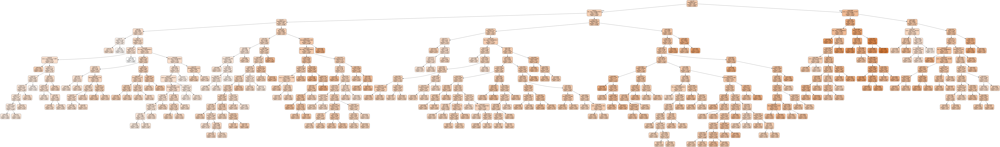

In [236]:
Image(graph.create_png())

In [237]:
# Feature importances
feature_im = pd.DataFrame({'importance':best_rf.steps[0][1].estimators_[0].feature_importances_, 'variable':X_test.columns})
feature_im.sort_values(by=['importance'], ascending=False).head(20)

,importance,variable
1,0.278212,languages
0,0.128802,film_date
6,0.093912,norm_unconvincing
7,0.067427,WC
43,0.045146,insight
78,0.027448,AllPunc
17,0.025787,you
91,0.017730,MoralityGeneral
20,0.016892,ipron
88,0.015901,Parenth


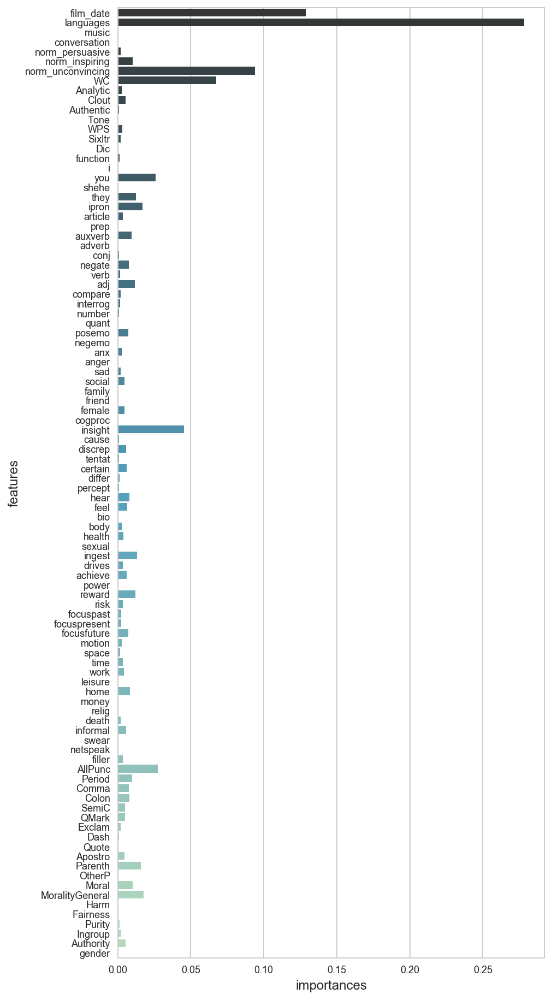

In [238]:
# Plotting the feature importances
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
# sns.countplot(y = feature_im.index() , x = 'importance', data=feature_im, palette='GnBu_d', orient='h');
fig = plt.figure(figsize=(7,16))
ax = fig.gca()

sns.barplot(y='variable',x='importance', data=feature_im, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

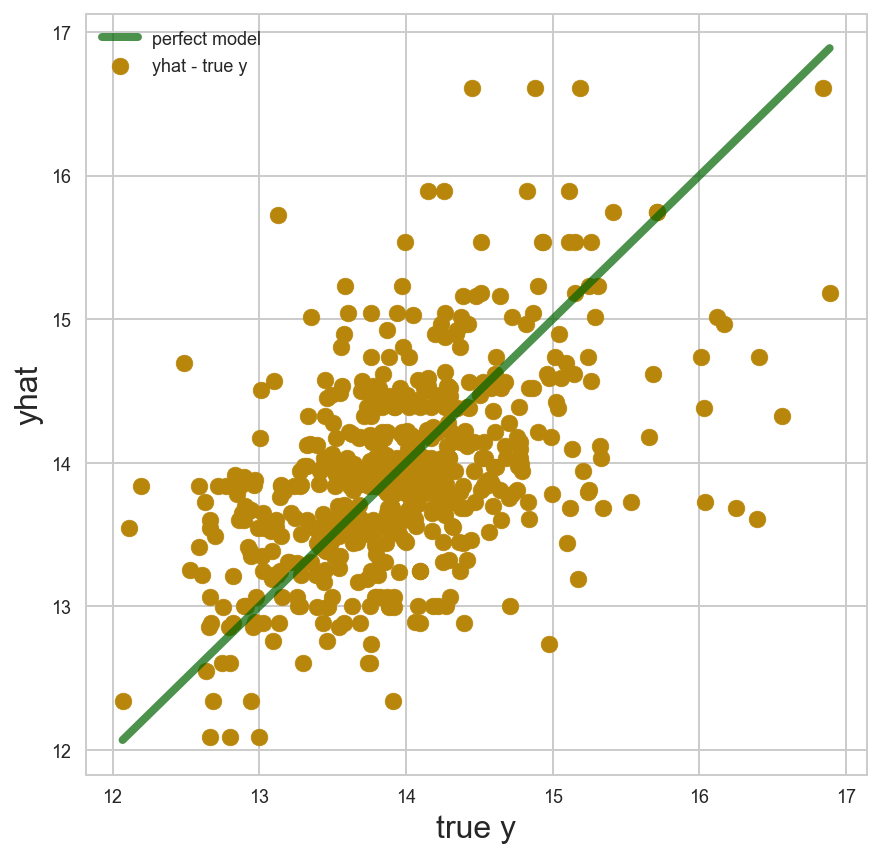

In [243]:
# Scatter plot to visualize the y values and predicted y values
def plot_y_yhat(y, yhat):

    fig = plt.figure(figsize=(7,7))
    ax = fig.gca()

    ax.scatter(y, yhat, color='darkgoldenrod', s=70, label='yhat - true y')

    max_val = np.max(y)
    min_val = np.min(y)

    ax.plot([min_val, max_val], [min_val, max_val], color='darkgreen',
            linewidth=4.0, alpha=0.7, label='perfect model')

    ax.set_xlabel('true y', fontsize=16)
    ax.set_ylabel('yhat', fontsize=16)

    plt.legend(loc='upper left')

    plt.show()
    
plot_y_yhat(y_test, best_rf.steps[0][1].estimators_[0].predict(X_test))

##### Results of Random Forest Model

The results of the Decision Tree model with 3-fold cross validated returned an R-squared value of 0.55, indicating that the model accounted for 55% of the variance in number of views for the TED Talk videos in this data set. The model had a RMSE value of 0.68 which is not bad given that the log transformed values of the number of views ranges between 12 and 17. As also can be seen in the above scatter plot, for most data point the predicted values are close to the true y values.

Looking at the feature importances of this model, we can see that the most important predictor of the number of views is the number of languages that the videos are translated to. This makes sense as the the subtitles makes the videos available to the speakers of other languages and thus can increase and decrease the number of views. Other top predictors of the view count are film date, total word count, normalized unconvincing votes and the use of insight words such as 'think and know'.
It's interesting to see that unconvincing votes and the words of insight are among the top predictors of the model. 

#### LinearSVR Pipeline

In [78]:
gs_lsvr = GridSearchCV(pipeline_LSVR, param_grid = parameters_LSVR , cv=3, n_jobs=1, verbose=1)
gs_lsvr.fit(X_train, y_train)

Fitting 3 folds for each of 100 candidates, totalling 300 fits


[Parallel(n_jobs=1)]: Done 300 out of 300 | elapsed:   23.8s finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('ss', RobustScaler(copy=True, quantile_range=(25.0, 75.0), with_centering=True,
       with_scaling=True)), ('lsvr', LinearSVR(C=1.0, dual=True, epsilon=0.0, fit_intercept=True,
     intercept_scaling=1.0, loss='epsilon_insensitive', max_iter=1000,
     random_state=None, tol=0.0001, verbose=0))]),
       fit_params=None, iid=True, n_jobs=1,
       param_grid={'lsvr__C': array([1.00000e-03, 1.20679e-03, 1.45635e-03, 1.75751e-03, 2.12095e-03,
       2.55955e-03, 3.08884e-03, 3.72759e-03, 4.49843e-03, 5.42868e-03,
       6.55129e-03, 7.90604e-03, 9.54095e-03, 1.15140e-02, 1.38950e-02,
       1.67683e-02, 2.02359e-02, 2.44205e-02, 2.94705e-02, 3....0, 8.28643e+00, 1.00000e+01]), 'lsvr__loss': ('epsilon_insensitive', 'squared_epsilon_insensitive')},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [80]:
print('Best Model Score:', gs_lsvr.best_score_)
print('Best Parameters:', gs_lsvr.best_params_)
print('Accuracy Score:', gs_lsvr.best_estimator_.score(X_test, y_test))
print('RMSE', np.sqrt(mean_squared_error(y_test, gs_lsvr.best_estimator_.predict(X_test))))

Best Model Score: 0.424390311649252
Best Parameters: {'lsvr__C': 1.5264179671752318, 'lsvr__loss': 'squared_epsilon_insensitive'}
Accuracy Score: 0.5177396786575321
RMSE 0.5032869822872289


In [81]:
LSVC_coef = pd.DataFrame({'variable': X.columns, 'LSVC_coef': gs_lsvr.best_estimator_.named_steps['lsvr'].coef_, 
                          'abs_coef': np.abs(gs_lsvr.best_estimator_.named_steps['lsvr'].coef_)})
LSVC_coef.sort_values('abs_coef', ascending=False).head(20)


,LSVC_coef,abs_coef,variable
78,-1.622893,1.622893,AllPunc
90,-1.258568,1.258568,Moral
80,0.717603,0.717603,Comma
87,0.599607,0.599607,Apostro
79,0.520605,0.520605,Period
95,0.470559,0.470559,Ingroup
1,0.469890,0.469890,languages
91,0.414394,0.414394,MoralityGeneral
92,0.397450,0.397450,Harm
88,0.387429,0.387429,Parenth


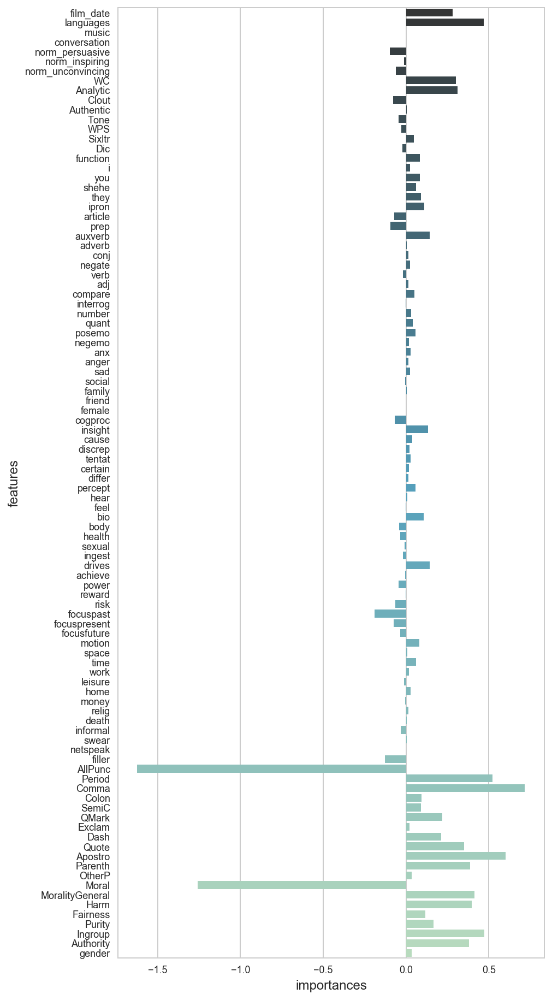

In [85]:
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
# sns.countplot(y = feature_im.index() , x = 'importance', data=feature_im, palette='GnBu_d', orient='h');
fig = plt.figure(figsize=(7,16))
ax = fig.gca()
sns.barplot(y='variable',x='LSVC_coef', data=LSVC_coef, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

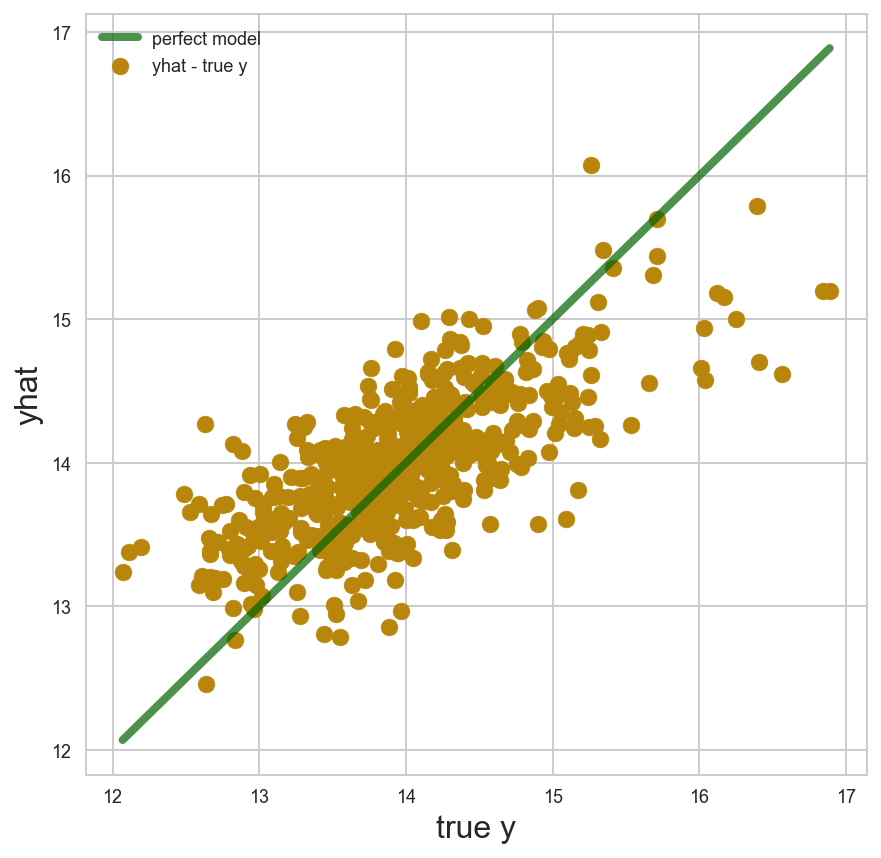

In [84]:
plot_y_yhat(y_test, gs_lsvr.best_estimator_.predict(X_test))

##### Results of LinearSVM Model

LinearSVM model performed similarly under 3-fold cross validation with 51% accounted variance (R-squared = 0.51). Comparing to Decision Tree Regressor, the LinearSVM seems to have a reduced error in prediction with 0.5 RMSE value. This also can be seen in the above scatter plot where true and predicted y values were plotted.  

Looking at the predictor coefficients of the LinearSVM model, we can see major changes in comparison to the Decision Tree Regressor. The top predictor of the model is use of all punctuation which has a negative influence on the number of views while the use of comma, period and apostrophes is among the positive predictors. This could be related to the use of parentheses as they were used to indicate a break within the talk for applause, laughter or music or other performances.

The next strongest predictor of the model is the number of words related to the Morality such as good, evil, ethic, moral, etc and has a negative relationship with the outcome variable. In addition, the ratio of 'Ingroup' moral category (e.g. together, family, foreign, traitor, etc.) is also one of the interesting positively related predictors of the number of views in this data set.

#### MLP Pipeline

In [ ]:
gs_MLP = GridSearchCV(pipeline_MLP, param_grid = parameters_MLP , cv=3, n_jobs=1, verbose=1)
gs_MLP.fit(X_train, y_train)

In [258]:
print('Best Model Score:', gs_MLP.best_score_)
print('Best Parameters:', gs_MLP.best_params_)
print('Accuracy Score:', gs_MLP.best_estimator_.score(X_test, y_test))

Best Model Score: 0.4390237902629409
Best Parameters: {'mlp__activation': 'identity', 'mlp__alpha': 10.0, 'mlp__hidden_layer_sizes': (50,), 'mlp__solver': 'sgd'}
Accuracy Score: 0.5211772066708409


In [146]:
# best model not to be used if needed
best_pipeline_MLP = Pipeline([
    ('rs', RobustScaler()),
    ('mlp', MLPRegressor(activation='identity',
                         alpha=10.0, 
                         hidden_layer_sizes=(50,),
                         solver='sgd',
                         random_state=1, 
                         max_iter=800))
])


In [147]:
# refitting the training set to the best estimator not to run the grid search again.
best_pipeline_MLP.fit(X_train,y_train)

Pipeline(memory=None,
     steps=[('rs', RobustScaler(copy=True, quantile_range=(25.0, 75.0), with_centering=True,
       with_scaling=True)), ('mlp', MLPRegressor(activation='identity', alpha=10.0, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(50,), learni...
       solver='sgd', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False))])

In [148]:
# calculating the error value
print('RMSE:', np.sqrt(mean_squared_error(y_test, best_pipeline_MLP.predict(X_test))))

RMSE: 0.5014900719758053


In [149]:
best_pipeline_MLP.named_steps['mlp']

MLPRegressor(activation='identity', alpha=10.0, batch_size='auto', beta_1=0.9,
       beta_2=0.999, early_stopping=False, epsilon=1e-08,
       hidden_layer_sizes=(50,), learning_rate='constant',
       learning_rate_init=0.001, max_iter=800, momentum=0.9,
       nesterovs_momentum=True, power_t=0.5, random_state=1, shuffle=True,
       solver='sgd', tol=0.0001, validation_fraction=0.1, verbose=False,
       warm_start=False)

##### Model Coefficients

It's a bit tricky to interpret the coefficients for the neural net model because even with one hidden layer (including 50 nodes) results with 98*50 + 50 = 4950 separate coefficients (98 features entering the model). In order to roughly see the features with the highest coefficient in each node, I looked at the absolute maximum coefficients.

In [172]:
# coefficients for each features entering the model
first_weights = pd.DataFrame(best_pipeline_MLP.named_steps['mlp'].coefs_[0], index=X.columns)
first_weights.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
film_date,-0.007178,-0.003422,-0.037523,0.013362,0.009306,0.019667,0.003361,0.002073,-0.010831,-0.007481,-0.000037,0.020428,-0.051125,0.008660,-0.005525,0.000639,-0.007140,0.015368,0.006437,0.010787,-0.046566,0.014591,-0.053469,0.019590,0.007443,0.032439,-0.015059,0.016419,-0.014124,0.044056,0.008548,-0.012899,-0.008039,0.011588,0.004168,0.027696,0.012774,0.026103,0.017158,0.002303,-0.006825,0.031625,-0.002403,0.037589,0.008886,-0.019818,-0.019603,-0.007263,0.027577,-0.014728
languages,-0.019829,-0.010483,-0.051828,0.025122,0.028207,0.037675,0.018165,0.002805,-0.010738,-0.008699,-0.006696,0.024479,-0.071061,0.000586,-0.001524,-0.002285,-0.005615,0.025591,0.033895,0.031476,-0.079671,-0.000574,-0.089899,0.033294,-0.002505,0.032069,-0.000523,0.039772,-0.005851,0.065594,0.037268,-0.014948,-0.024028,0.015494,-0.006522,0.061302,0.014129,0.042012,0.048528,-0.002697,-0.036561,0.054152,0.004278,0.053114,0.027558,-0.037287,-0.037688,-0.004118,0.043551,-0.009068
music,-0.003675,0.000574,0.008181,-0.003025,0.008660,0.002615,-0.010263,0.009103,0.004046,0.010542,-0.006945,-0.007692,0.009170,0.004172,-0.009199,0.005415,0.005381,0.008967,0.004484,-0.007964,-0.010177,-0.010043,-0.009998,-0.005380,0.007631,0.000823,0.001120,0.007250,-0.007966,-0.004681,0.001818,0.009954,0.001294,-0.010203,0.006372,-0.005660,0.006510,-0.002377,0.007706,0.005238,0.001192,-0.007706,-0.009328,-0.008026,-0.009654,-0.008320,-0.005814,0.004515,0.001266,-0.010332
conversation,-0.009073,0.009905,0.001444,-0.006289,-0.005250,0.005168,-0.006456,0.001725,0.009963,0.007352,-0.005514,-0.000132,0.002543,0.006973,-0.007275,-0.010205,-0.009114,-0.000289,0.002254,0.001459,-0.003871,0.010357,0.001690,-0.002541,0.001080,0.005200,0.003587,-0.004983,-0.009192,-0.002754,0.002750,-0.006143,0.005358,-0.009188,-0.005081,0.006460,-0.006498,0.002956,0.000523,0.009005,-0.005017,-0.009200,0.004983,0.005769,0.008644,0.009156,-0.010303,-0.005631,0.002475,0.009518
norm_persuasive,0.011468,0.003471,0.019059,-0.003494,-0.009345,-0.012072,-0.001696,0.000507,0.014493,0.013784,-0.003826,0.001974,0.011628,-0.007146,-0.009153,0.003109,-0.008214,0.005402,0.001976,-0.016319,0.015411,-0.005873,0.013135,0.000901,-0.002056,-0.001836,0.005534,-0.003472,0.010841,-0.005821,-0.007742,0.006891,0.014105,-0.008503,-0.002160,-0.011143,-0.013018,-0.005735,-0.013751,0.007454,0.003669,-0.002168,0.001978,-0.020772,-0.000303,0.009765,0.003516,-0.001646,-0.009072,0.011814


In [168]:
# absolute weights of the features in the hidden layer
first_weights =np.abs(first_weights)
first_weights2.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,40,41,42,43,44,45,46,47,48,49
film_date,0.007178,0.003422,0.037523,0.013362,0.009306,0.019667,0.003361,0.002073,0.010831,0.007481,0.000037,0.020428,0.051125,0.008660,0.005525,0.000639,0.007140,0.015368,0.006437,0.010787,0.046566,0.014591,0.053469,0.019590,0.007443,0.032439,0.015059,0.016419,0.014124,0.044056,0.008548,0.012899,0.008039,0.011588,0.004168,0.027696,0.012774,0.026103,0.017158,0.002303,0.006825,0.031625,0.002403,0.037589,0.008886,0.019818,0.019603,0.007263,0.027577,0.014728
languages,0.019829,0.010483,0.051828,0.025122,0.028207,0.037675,0.018165,0.002805,0.010738,0.008699,0.006696,0.024479,0.071061,0.000586,0.001524,0.002285,0.005615,0.025591,0.033895,0.031476,0.079671,0.000574,0.089899,0.033294,0.002505,0.032069,0.000523,0.039772,0.005851,0.065594,0.037268,0.014948,0.024028,0.015494,0.006522,0.061302,0.014129,0.042012,0.048528,0.002697,0.036561,0.054152,0.004278,0.053114,0.027558,0.037287,0.037688,0.004118,0.043551,0.009068
music,0.003675,0.000574,0.008181,0.003025,0.008660,0.002615,0.010263,0.009103,0.004046,0.010542,0.006945,0.007692,0.009170,0.004172,0.009199,0.005415,0.005381,0.008967,0.004484,0.007964,0.010177,0.010043,0.009998,0.005380,0.007631,0.000823,0.001120,0.007250,0.007966,0.004681,0.001818,0.009954,0.001294,0.010203,0.006372,0.005660,0.006510,0.002377,0.007706,0.005238,0.001192,0.007706,0.009328,0.008026,0.009654,0.008320,0.005814,0.004515,0.001266,0.010332
conversation,0.009073,0.009905,0.001444,0.006289,0.005250,0.005168,0.006456,0.001725,0.009963,0.007352,0.005514,0.000132,0.002543,0.006973,0.007275,0.010205,0.009114,0.000289,0.002254,0.001459,0.003871,0.010357,0.001690,0.002541,0.001080,0.005200,0.003587,0.004983,0.009192,0.002754,0.002750,0.006143,0.005358,0.009188,0.005081,0.006460,0.006498,0.002956,0.000523,0.009005,0.005017,0.009200,0.004983,0.005769,0.008644,0.009156,0.010303,0.005631,0.002475,0.009518
norm_persuasive,0.011468,0.003471,0.019059,0.003494,0.009345,0.012072,0.001696,0.000507,0.014493,0.013784,0.003826,0.001974,0.011628,0.007146,0.009153,0.003109,0.008214,0.005402,0.001976,0.016319,0.015411,0.005873,0.013135,0.000901,0.002056,0.001836,0.005534,0.003472,0.010841,0.005821,0.007742,0.006891,0.014105,0.008503,0.002160,0.011143,0.013018,0.005735,0.013751,0.007454,0.003669,0.002168,0.001978,0.020772,0.000303,0.009765,0.003516,0.001646,0.009072,0.011814


* below data framne displays the features with highest absolute coefficients on each node and the coefficients from that node to the output.

In [171]:
# weights for each node in the hidden layer
second_weights = pd.DataFrame({'highest_coef_feature_on_each_node':[first_weights2.loc[first_weights2[i]==first_weights2.iloc[:,i].max(),i].index[0] for i in range(0,50)],
                               'highest_abs_coef_on_each_node':[first_weights2.iloc[:,i].max() for i in range(0,50)],
                               'hidden_layer_nodes_to_output_coef':[weight[0] for weight in best_pipeline_MLP.named_steps['mlp'].coefs_[1]],
                               })
second_weights

,hidden_layer_nodes_to_output_coef,highest_abs_coef_on_each_node,highest_coef_feature_on_each_node
0,-0.071749,0.019829,languages
1,-0.112752,0.012485,Exclam
2,-0.341875,0.051828,languages
3,0.228106,0.025122,languages
4,0.212975,0.028207,languages
5,0.352581,0.037675,languages
6,0.122896,0.019126,Moral
7,0.078972,0.012951,health
8,-0.082689,0.017310,Moral
9,-0.090340,0.017577,Moral


##### Results of the MLPRegressor Model

As a result of a grid search for a MLP Regressor, the number of nodes for the best performing model was 50 with identity activation function. The R-squared score returned by the cross validated model was 0.52, indicating that the neural network model explained about 52% of the variance in the number of views and had a 0.5 RMSE. Even though the model has a lower error than the Decision Tree model, the Decision Tree model returned a better R-squared value.

Looking at the absolute coefficients above, we can see that the number of languages that the videos were translated to is the feature with the highest absolute coefficient entering the hidden layer neurons suggesting a similar result with the Decision Tree model. On the other hand, on other neurons it appears that the 'Moral' variable has a higher absolute weight which points out an agreement with the results of SVM model.

Even though the model has a lower error rate in comparison to the Decision Tree model, I'd still prefer to use the latter as it is easier to interpret and has a slightly better performance in explaining the variance in the outcome variable.

#### Linear Regression Models

In addition to the above models, I've also tested the performance of a multiple linear regression and linear regression with Ridge and Lasso regularizations. Please see their results below:

##### Multiple Linear Regression

In [244]:
# using Robust Scaler 
rs = RobustScaler()

In [245]:
# scaling the train and test sests
rs.fit(X_train)
X_train_s = rs.transform(X_train)
X_test_s = rs.transform(X_test)

In [246]:
lr = LinearRegression()
lr.fit(X_train_s, y_train)
print('R-squared: ', cross_val_score(lr, X_train_s, y_train, cv = 6).mean())

R-squared:  0.4516247222028547


##### Ridge Regularization

In [247]:
# finding the best alpha on the training set
alpha_values = np.logspace(-3,3,50)
mod_ridge = RidgeCV(alphas=alpha_values,  cv=6)
mod_ridge.fit(X_train_s, y_train)
best_alpha = mod_ridge.alpha_

# creating another ridge model with the best alpha to test it again on the training set
best_r_m = Ridge(alpha = best_alpha)
print('Scores: ', cross_val_score(best_r_m, X_train_s, y_train, cv=6))
print('Mean Score: ', cross_val_score(best_r_m, X_train_s, y_train, cv=6).mean())

Scores:  [0.49983239 0.41766622 0.52143078 0.44414168 0.51991947 0.37720289]
Mean Score:  0.4633655694939438


##### Lasso Regularization

In [248]:
# finding the best alpha on the training set
mod_lasso = LassoCV(n_alphas = 500, alphas=np.logspace(-3,3,100), cv=6)
mod_lasso.fit(X_train_s, y_train)

# creating another lasso model with the best alpha
best_alpha = mod_lasso.alpha_
best_lm = Lasso(alpha=best_alpha)
print('Scores: ', cross_val_score(best_lm, X_train_s, y_train, cv=6))
print('Mean Score: ', cross_val_score(best_lm, X_train_s, y_train, cv=6).mean())

Scores:  [0.51232891 0.4258184  0.52377287 0.44269957 0.51295769 0.40780161]
Mean Score:  0.47089651011780614


In [249]:
print('R-squared score of the Lasso Model: ', best_lm.fit(X_train_s, y_train).score(X_test_s, y_test))
print('Model Intercept: ', best_lm.intercept_)
print('RMSE: ', np.sqrt(mean_squared_error(y_test, best_lm.predict(X_test_s))))

R-squared score of the Lasso Model:  0.5348177109845036
Model Intercept:  13.948801803884656
RMSE:  0.49429534148158644


In [250]:
Lasso_coef = pd.DataFrame({'variable': X.columns, 'Lasso_coef': best_lm.coef_, 'abs_coef': np.abs(best_lm.coef_)})
Lasso_coef.sort_values('abs_coef', ascending=False).head(20)

,Lasso_coef,abs_coef,variable
1,0.446698,0.446698,languages
7,0.277732,0.277732,WC
0,0.261991,0.261991,film_date
62,-0.109209,0.109209,focuspast
88,0.109035,0.109035,Parenth
4,-0.086874,0.086874,norm_persuasive
43,0.076253,0.076253,insight
6,-0.073451,0.073451,norm_unconvincing
79,-0.055797,0.055797,Period
29,0.041819,0.041819,compare


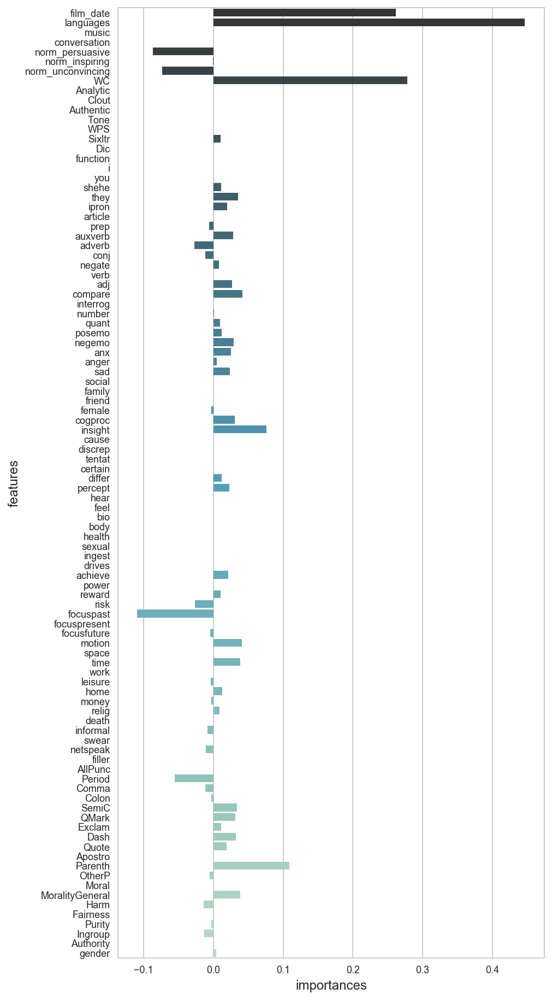

In [251]:
fig = plt.figure(figsize=(7,16))
ax = fig.gca()
sns.barplot(y='variable',x='Lasso_coef', data=Lasso_coef, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

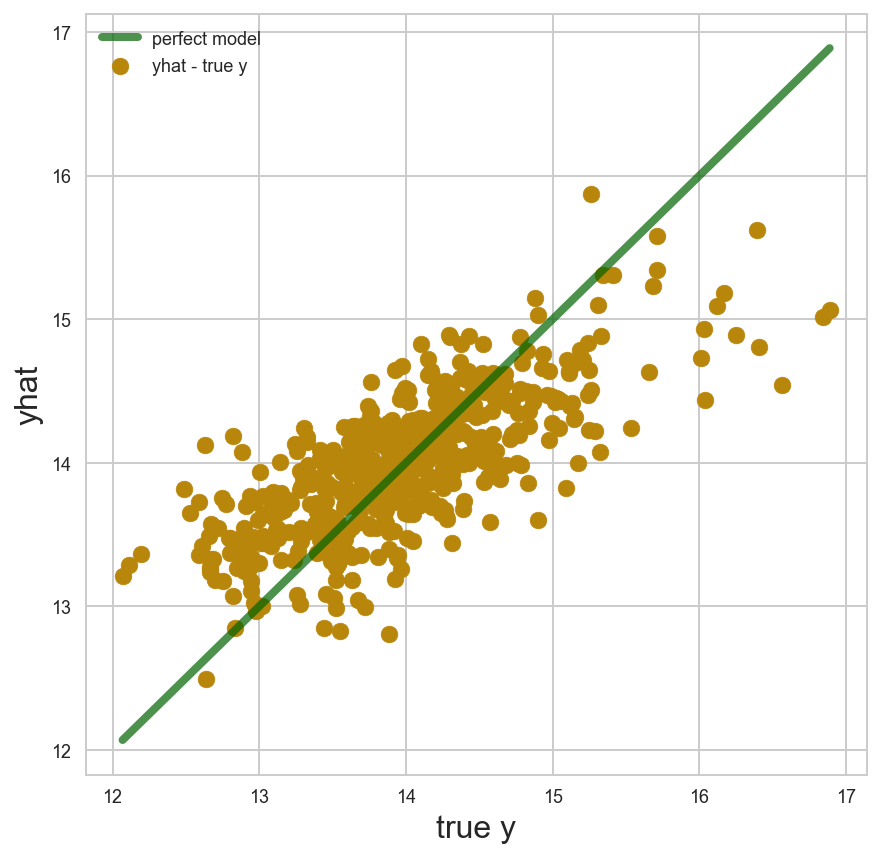

In [252]:
plot_y_yhat(y_test, best_lm.predict(X_test_s))

##### Results of the Linear Regression Models

As the Lasso regularization was the best performing model out of Multiple Linear Regression and Ridge regularization, I decided to continue the analyses with the Lasso model. The performance of this model was also very similar to the previous models. It returned an R-squared score of 0.53, and an RMSE score 0.49. In terms of the error score, it appears to slightly differ from the other models. As the above scatter plot suggests, the most of the predictions are close to the correct values of the views.

Looking at the predictors of this model, we can see a high agreement with the Decision Tree model. The strongest predictors of the Lasso model seems to be the number of languages, film date and the word count. The frequency of the use of parenthesis is also a positive predictor of this model which may indicate that the talks that includes more applause and laughter has a positive contribution to the views. The strongest negative predictor of the outcome is the number of past focusing words such as ago, did, or the verbs in past tense. This is interesting and may provide some insights in terms of the ideas presented in the TED talks. For example, it may be related to the fact that the ideas about the future or the current matters might be more interesting to the viewers. This can be further investigated by collecting additional data from the viewers.

## Predicting Gender

I wanted to test if the LIWC and Morality features help in predicting the genders of the presenters. As shown in the data cleaning and the EDA of my project, the gender variable was created using gender-guesser library, genderize.io API and the manual work.


In [264]:
y = df_.gender

<b> Baseline Accuracy </b>

In [265]:
y.mean()

0.6776814734561214

In [266]:
X = df_[['film_date', 'languages','music',
         'conversation','norm_persuasive','norm_unconvincing','norm_inspiring', 'WC','Analytic',
         'Clout','Authentic','Tone','WPS','Sixltr','Dic','function','i','you','shehe','they','ipron',
         'article','prep','auxverb','adverb','conj','negate','verb','adj','compare','interrog','number',
        'quant','posemo','negemo','anx','anger','sad','social','family','friend','female','cogproc',
        'insight','cause','discrep','tentat','certain','differ','percept','hear','feel','bio','body',
        'health','sexual','ingest','drives','achieve','power','reward','risk','focuspast','focuspresent',
        'focusfuture','motion','space','time','work','leisure','home','money','relig','death','informal',
        'swear','netspeak','filler','AllPunc','Period','Comma','Colon','SemiC','QMark','Exclam','Dash','Quote',
        'Apostro','Parenth','OtherP','Moral','MoralityGeneral','Harm','Fairness','Purity','Ingroup','Authority'
         ]]

In [267]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state = 1, stratify=y)
rs = RobustScaler()
rs.fit(X_train)
X_train_s = rs.transform(X_train)
X_test_s = rs.transform(X_test)

### Random Forest Classifier

In [268]:
# Random Forest Pipeline
pipeline_RFC = Pipeline([
    ('rfc', RandomForestClassifier(n_estimators=30)),
])

parameters_RFC = {"rfc__max_depth": (3, 6, 10, 15, None),
              "rfc__max_features": ('sqrt', 'log2', None, 0.2, 0.5, 0.7),
              "rfc__min_samples_split": (2, 3, 10, 20, 50),
              "rfc__min_samples_leaf": (1, 3, 10, 20, 50),
              "rfc__bootstrap": (True, False),
              "rfc__criterion": ("gini", "entropy")}

In [269]:
# Grid Searching for the 
gs_rfc = GridSearchCV(pipeline_RFC, param_grid = parameters_RFC, cv=3, n_jobs=-1, verbose=1)

In [119]:

gs_rfc.fit(X_train, y_train)

Fitting 3 folds for each of 3000 candidates, totalling 9000 fits


[Parallel(n_jobs=-1)]: Done  76 tasks      | elapsed:    2.3s
[Parallel(n_jobs=-1)]: Done 376 tasks      | elapsed:   18.6s
[Parallel(n_jobs=-1)]: Done 752 tasks      | elapsed:   46.0s
[Parallel(n_jobs=-1)]: Done 1114 tasks      | elapsed:  1.4min
[Parallel(n_jobs=-1)]: Done 1574 tasks      | elapsed:  2.2min
[Parallel(n_jobs=-1)]: Done 2132 tasks      | elapsed:  3.2min
[Parallel(n_jobs=-1)]: Done 2819 tasks      | elapsed:  4.0min
[Parallel(n_jobs=-1)]: Done 3569 tasks      | elapsed:  5.7min
[Parallel(n_jobs=-1)]: Done 4427 tasks      | elapsed:  7.5min
[Parallel(n_jobs=-1)]: Done 5377 tasks      | elapsed:  9.4min
[Parallel(n_jobs=-1)]: Done 6427 tasks      | elapsed: 12.2min
[Parallel(n_jobs=-1)]: Done 7577 tasks      | elapsed: 15.3min
[Parallel(n_jobs=-1)]: Done 8827 tasks      | elapsed: 19.7min
[Parallel(n_jobs=-1)]: Done 9000 out of 9000 | elapsed: 20.5min finished


GridSearchCV(cv=3, error_score='raise',
       estimator=Pipeline(memory=None,
     steps=[('rfc', RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='auto', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=30, n_jobs=1,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False))]),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'rfc__max_depth': (3, 6, 10, 15, None), 'rfc__max_features': ('sqrt', 'log2', None, 0.2, 0.5, 0.7), 'rfc__min_samples_split': (2, 3, 10, 20, 50), 'rfc__min_samples_leaf': (1, 3, 10, 20, 50), 'rfc__bootstrap': (True, False), 'rfc__criterion': ('gini', 'entropy')},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [120]:
# Model Scores, best parameters
print('Best Model Score:', gs_rfc.best_score_)
print('Best Parameters:', gs_rfc.best_params_)
print('Accuracy Score:', gs_rfc.best_estimator_.score(X_test, y_test))

Best Model Score: 0.7321981424148607
Best Parameters: {'rfc__bootstrap': False, 'rfc__criterion': 'entropy', 'rfc__max_depth': None, 'rfc__max_features': 0.5, 'rfc__min_samples_leaf': 10, 'rfc__min_samples_split': 3}
Accuracy Score: 0.703971119133574


In [270]:
# saving the best estimator not to run the grid search again
best_rf = RandomForestClassifier(bootstrap=False, class_weight=None,
            criterion='entropy', max_depth=None, max_features=0.5,
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=10,
            min_samples_split=3, min_weight_fraction_leaf=0.0,
            n_estimators=30, n_jobs=1, oob_score=False, random_state=None,
            verbose=0, warm_start=False)

In [272]:
# best_rf = gs_rfc.best_estimator_
best_rf.fit(X_train_s, y_train)

RandomForestClassifier(bootstrap=False, class_weight=None,
            criterion='entropy', max_depth=None, max_features=0.5,
            max_leaf_nodes=None, min_impurity_decrease=0.0,
            min_impurity_split=None, min_samples_leaf=10,
            min_samples_split=3, min_weight_fraction_leaf=0.0,
            n_estimators=30, n_jobs=1, oob_score=False, random_state=None,
            verbose=0, warm_start=False)

In [273]:
dot_data = StringIO()
export_graphviz(best_rf.estimators_[0], out_file=dot_data,
                feature_names=X_train.columns,
#                 class_names=best_rf[0].feature_names,
               filled=True, rounded=True,
                proportion=True,
                special_characters=True,
                node_ids=True)
graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

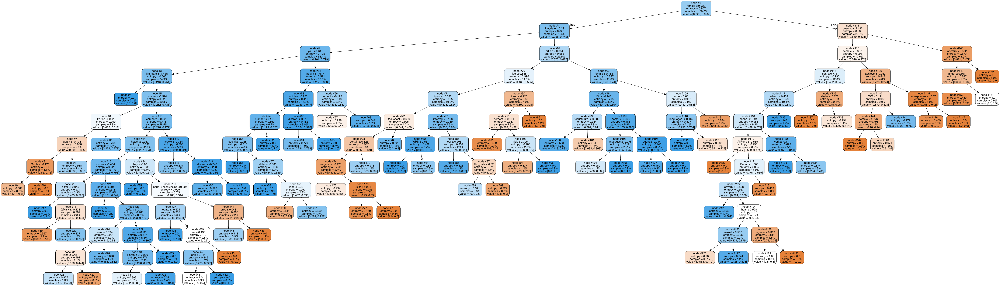

In [274]:
Image(graph.create_png())

In [275]:
feature_im = pd.DataFrame({'importance':best_rf.estimators_[0].feature_importances_, 'variable':X_test.columns})
feature_im.sort_values(by=['importance'], ascending=False).head(20)

,importance,variable
41,0.128619,female
0,0.056999,film_date
21,0.039845,article
51,0.036494,feel
54,0.030435,health
83,0.029169,QMark
48,0.028935,differ
20,0.028932,ipron
31,0.028493,number
18,0.027757,shehe


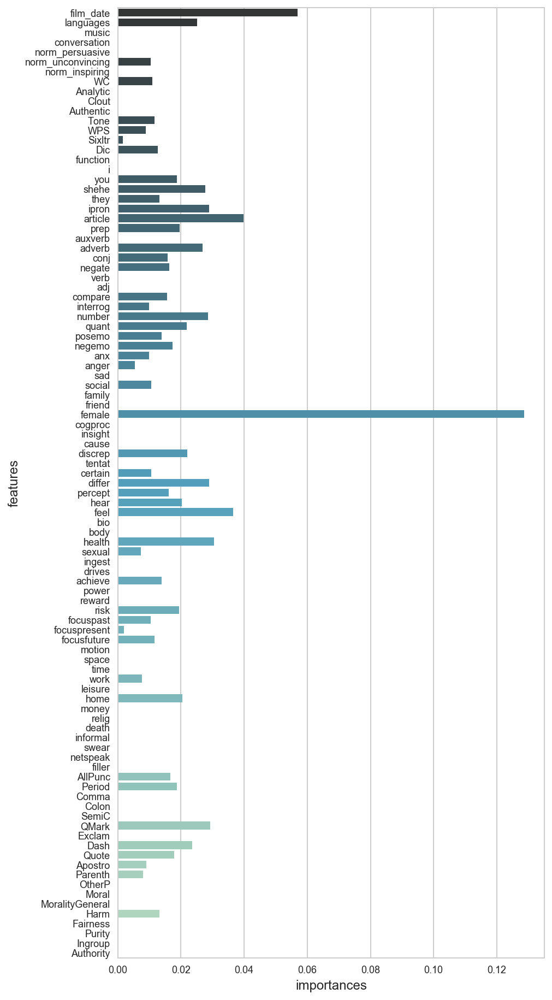

In [276]:
fig = plt.figure(figsize=(7,16))
ax = fig.gca()
sns.barplot(y='variable',x='importance', data=feature_im, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('importances', fontsize=12);

In [278]:
fpr_rf, tpr_rf, treshold_rf = roc_curve(y_test, best_rf.predict(X_test))
roc_auc_rf = auc(fpr_rf, tpr_rf)

### Logistic Regression 

In [ ]:
gs_params = {'penalty':['l1','l2'],
             'solver':['liblinear'],
             'C':np.logspace(-5,3,50)}
mod_2 = GridSearchCV(LogisticRegression(), gs_params, cv=3, verbose=1, n_jobs=6)
mod_2.fit(X_train_s, y_train)

In [772]:
# Model Scores, best parameters and the intercept
print('Best Model Score:', mod_2.best_score_)
print('Best Parameters:', mod_2.best_params_)
print('Accuracy Score:', mod_2.best_estimator_.score(X_test_s, y_test))
print('Coefficient:', mod_2.best_estimator_.intercept_)

Best Model Score: 0.7213622291021672
Best Parameters: {'C': 0.026826957952797246, 'penalty': 'l2', 'solver': 'liblinear'}
Accuracy Score: 0.7292418772563177
Coefficient for Houston: [0.38722152]


In [281]:
mod_2 = LogisticRegression(C= 0.026826957952797246, penalty= 'l2', solver='liblinear').fit(X_train_s, y_train)

In [288]:
mod_2

LogisticRegression(C=0.026826957952797246, class_weight=None, dual=False,
          fit_intercept=True, intercept_scaling=1, max_iter=100,
          multi_class='ovr', n_jobs=1, penalty='l2', random_state=None,
          solver='liblinear', tol=0.0001, verbose=0, warm_start=False)

In [291]:
feature_im = pd.DataFrame({'coef': mod_2.coef_[0], 'abs_coef': np.abs(mod_2.coef_[0]), 'variable':X_test.columns})
feature_im.sort_values(by=['abs_coef'], ascending=False).head(20)

,abs_coef,coef,variable
21,0.333380,0.333380,article
41,0.269917,-0.269917,female
25,0.262716,-0.262716,conj
31,0.224508,0.224508,number
18,0.211184,0.211184,shehe
17,0.205379,0.205379,you
0,0.205136,-0.205136,film_date
80,0.176072,0.176072,Comma
79,0.174899,0.174899,Period
88,0.170043,0.170043,Parenth


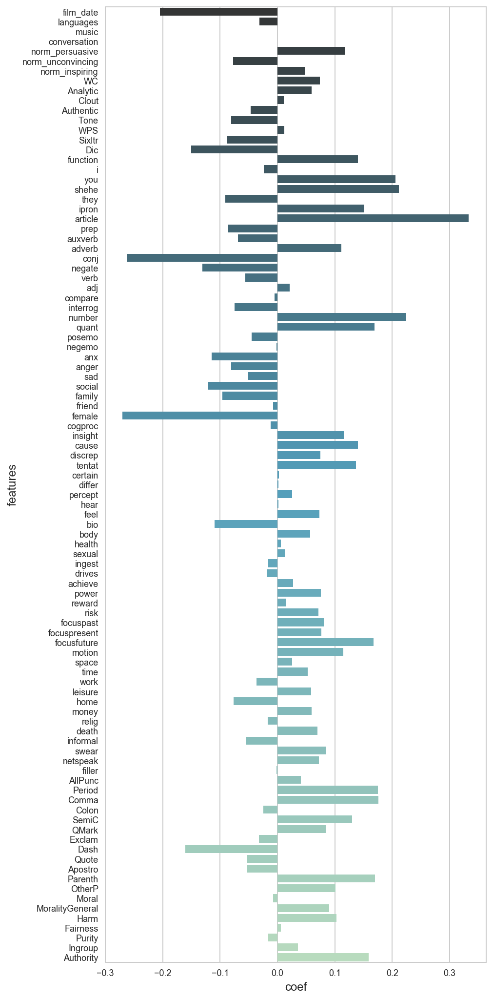

In [293]:
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
fig = plt.figure(figsize=(7,18))
ax = fig.gca()
sns.barplot(y='variable',x='coef', data=feature_im, palette='GnBu_d');
ax.set_ylabel('features', fontsize=12)
ax.set_xlabel('coef', fontsize=12);

In [294]:
mod2_yhat = mod_2.predict(X_test_s)
confusion = confusion_matrix(y_test, mod2_yhat, labels=[1,0])
pd.DataFrame(confusion, columns=['pred_male', 'pred_female'], index=['male', 'female'])

,pred_male,pred_female
male,330,45
female,109,70


In [295]:
print(classification_report(y_test, mod2_yhat))

             precision    recall  f1-score   support

          0       0.61      0.39      0.48       179
          1       0.75      0.88      0.81       375

avg / total       0.71      0.72      0.70       554



In [296]:
fpr_lr, tpr_lr, treshold_lr = roc_curve(y_test, mod2_yhat)
roc_auc_lr = auc(fpr_lr, tpr_lr)

### KNN Classifier

In [297]:
knn_params = {'n_neighbors':[3,9,12,15,25],
             'weights':['uniform','distance'],
            'metric':['euclidean','manhattan']}
mod_3 = GridSearchCV(KNeighborsClassifier(), knn_params, cv=3, n_jobs=-1, verbose=1)
mod_3.fit(X_train_s, y_train)

Fitting 3 folds for each of 20 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Done  42 tasks      | elapsed:    2.2s
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed:    3.0s finished


GridSearchCV(cv=3, error_score='raise',
       estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
           metric_params=None, n_jobs=1, n_neighbors=5, p=2,
           weights='uniform'),
       fit_params=None, iid=True, n_jobs=-1,
       param_grid={'n_neighbors': [3, 9, 12, 15, 25], 'weights': ['uniform', 'distance'], 'metric': ['euclidean', 'manhattan']},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=1)

In [298]:
# Model Scores, best parameters and the intercept
print('Best Model Score:', mod_3.best_score_)
print('Best Parameters:', mod_3.best_params_)
print('Accuracy Score:', mod_3.best_estimator_.score(X_test_s, y_test))

Best Model Score: 0.7020123839009288
Best Parameters: {'metric': 'euclidean', 'n_neighbors': 15, 'weights': 'uniform'}
Accuracy Score: 0.6931407942238267


In [302]:
# confusion matrix for the KNN model
mod3_yhat = mod_3.best_estimator_.predict(X_test_s)
confusion = confusion_matrix(y_test, mod3_yhat, labels=[1,0])
pd.DataFrame(confusion, columns=['pred_male', 'pred_female'], index=['male', 'female'])

,pred_male,pred_female
male,339,36
female,134,45


In [303]:
# classification report
print(classification_report(y_test, mod3_yhat))

             precision    recall  f1-score   support

          0       0.56      0.25      0.35       179
          1       0.72      0.90      0.80       375

avg / total       0.66      0.69      0.65       554



In [300]:
fpr_knn, tpr_knn, treshold_knn = roc_curve(y_test, mod3_yhat)
roc_auc_knn = auc(fpr_knn, tpr_knn)

### ROC Curves

In [304]:
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)

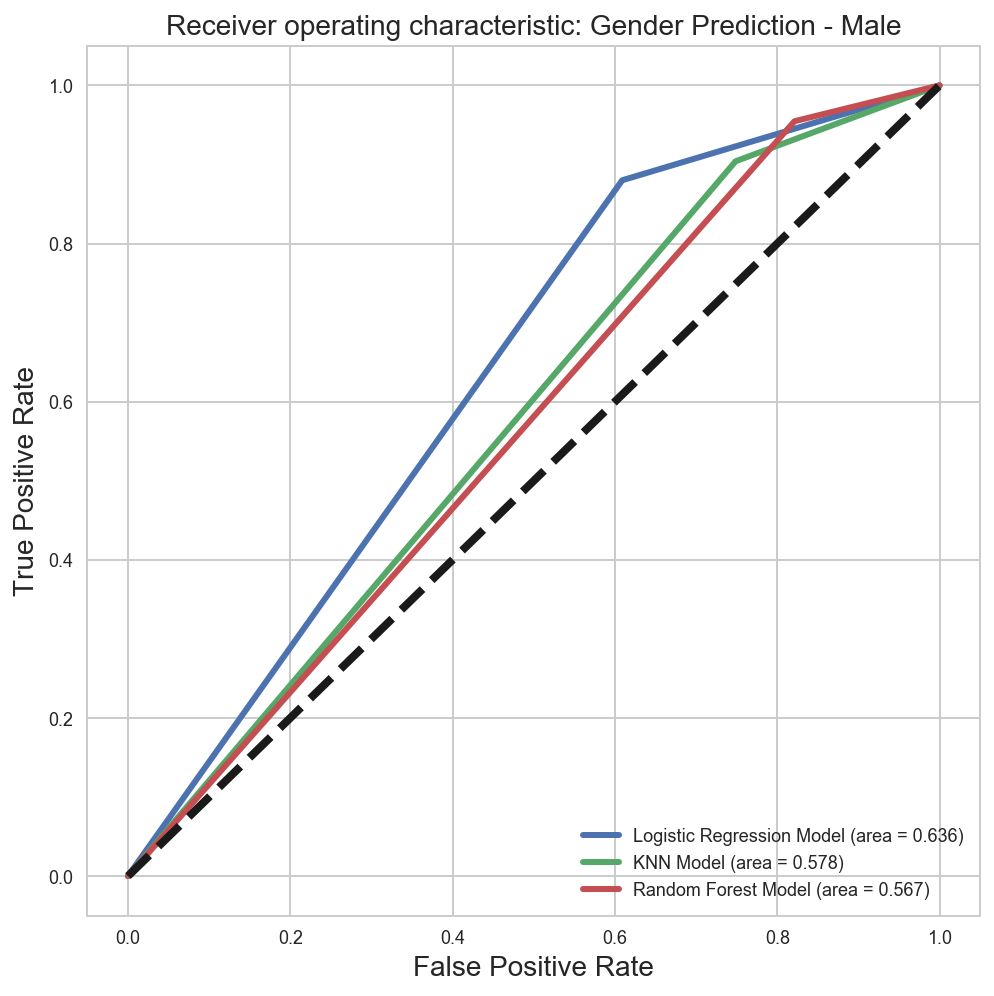

In [305]:
fig, ax = plt.subplots(figsize=(8,8))

ax.plot(fpr_lr, tpr_lr, label='Logistic Regression Model (area = %0.3f)' %roc_auc_lr, linewidth=3)
ax.plot(fpr_knn, tpr_knn, label='KNN Model (area = %0.3f)' %roc_auc_knn, linewidth=3)
ax.plot(fpr_rf, tpr_rf, label='Random Forest Model (area = %0.3f)' %roc_auc_rf, linewidth=3)
ax.plot([0, 1], [0, 1], 'k--', linewidth=4)

ax.set_xlabel('False Positive Rate', fontsize=14)
ax.set_ylabel('True Positive Rate', fontsize=14)
ax.set_title('Receiver operating characteristic: Gender Prediction - Male', fontsize=14)
ax.legend(loc="lower right");

### Summary of Gender Classification Models and Results

In order to predict the gender based on the LIWC, Morality and video features selected previously in the view prediction section, I have used Grid Searched Logistic Regression, KNN and Random Forest Classifiers.

The baseline accuracy for gender (1 being male and 0 being female) in this dataset is 0.67 indicating that there's 67% chance of accurately classifying a male with random selection. The accuracy scores of these 3 fold Cross Validated models are:

* KNN: 0.69
* Random Forest: 0.70
* Logistic Regression: 0.72

According to the above accuracy scores, Logistic Regression model is the best performing model with average precision score of 0.71 and average recall of 0.72. As the above ROC curves also depict, the Logistic Regression model had a higher True Positive and lower False Positive rate overall. 

The model was very successful in terms of predicting the male speakers, but it wasn't very good at classifying female speakers. The recall score for male speakers was 0.88 suggesting that the model was able to classify 88% of the male speakers correctly. This is probably related to the size of the female class as it was almost half of the male class and the gender information in this dataset is limited to the correctness of the libraries used to create this feature.

The top positive predictors of the Logistic Regression model are:

* pronouns: you, heshe
* articles
* number

The top negative predictors:

* female
* conjunction
* film date






## EDA on Words

In [738]:
from sklearn.base import BaseEstimator
from sklearn.base import TransformerMixin
# lemmatizing the words
def getlemmatized(x):
    
    x = x.lower()
    
    tb = TextBlob(x)
    words_and_pos = tb.tags
    lemmatized_statement = []
    
    for word, pos in words_and_pos:
        
        if pos[0]=='V': use_pos='v'
        elif pos[0]=='N': use_pos='n'
        elif pos[0]=='R': use_pos='r'
        elif pos[0]=='J': use_pos='a'
        else: use_pos=None
        
        lemmatized_word = word.lemmatize(use_pos)
        
        if "'" not in word:
            lemmatized_statement.append(lemmatized_word)
    
    lemmatized_statement = ' '.join(lemmatized_statement)
    
    return lemmatized_statement

# class to exctact the lemmatized words

class ExtractLemmatized(BaseEstimator,TransformerMixin):
    """Takes in df, outputs readability column"""

    def __init__(self, column_choice):
        self.column_choice = column_choice
        pass

    def transform(self, df, y=None):
        """Returns readability column"""
        column = df[self.column_choice].map(getlemmatized)
        return  column

    def fit(self, df, y=None):
        return self

### Overall 

In [739]:
df_try = df.copy()

In [740]:
df_try['lemmatized'] = df_try.transcript.map(getlemmatized)

In [775]:
def truncate_colormap(cmap, minval=0.0, maxval=1.0, n=100):
    '''
    Takes a matplotlib colormap string, as well as a minimum and maximum threshold for sampling that colormap.
    The default is to sample the entire colormap (from 0.0 to 1.0) 100 times.
    Returns a new colormap object.
    '''
    
    #obtaining the colormap object from the associated string
    cmap = plt.get_cmap(cmap)
    
    #creating a new colormap by sampling within the minimum and maximum threshold
    new_cmap = colors.LinearSegmentedColormap.from_list(
        'truncated_{}'.format(cmap.name),
         cmap(np.linspace(minval, maxval, n)))
    
    return new_cmap

ocean_truncated = truncate_colormap('ocean', 0.0, 0.7)
cmr_truncated = truncate_colormap('CMRmap',0.1,0.75)

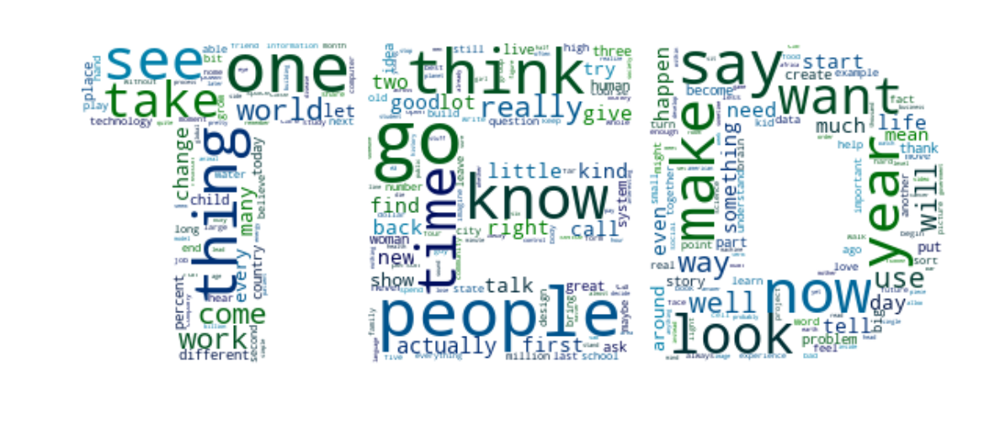

In [776]:
#creating a mask from a picture of the TED logo
nhm_mask = np.array(Image.open(('ted.jpg')))


#creating a WordCloud with the top 500 single words from the lemmatized text

wc = WordCloud(background_color='white',
               max_words=500,
               mask=nhm_mask,
               colormap=ocean_truncated,
               collocations=False).generate(' '.join(df_try['lemmatized']))

#saving the resulting WordCloud image
wc.to_file('ted_wordcloud_1.png')

#displaying the WordCloud
plt.figure(figsize=[10,10])
plt.imshow(wc, interpolation='bilinear')
plt.axis("off")
plt.show()

### Topic Categories

technology_th


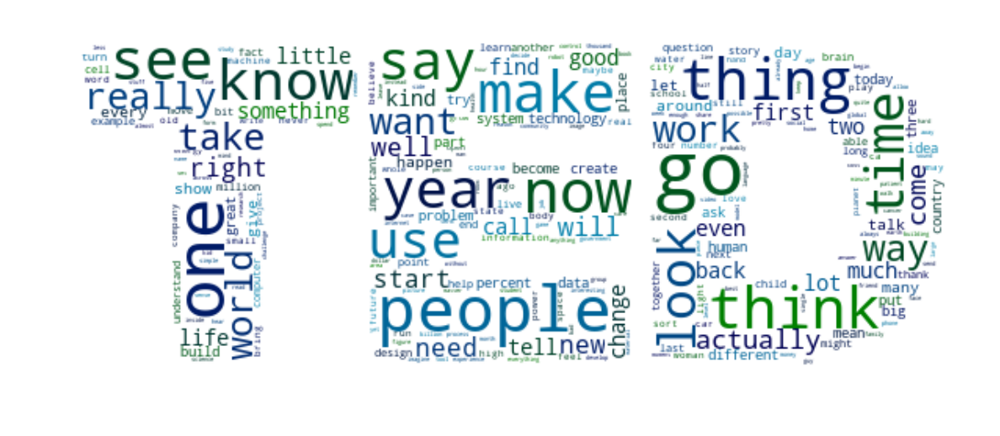

society_th


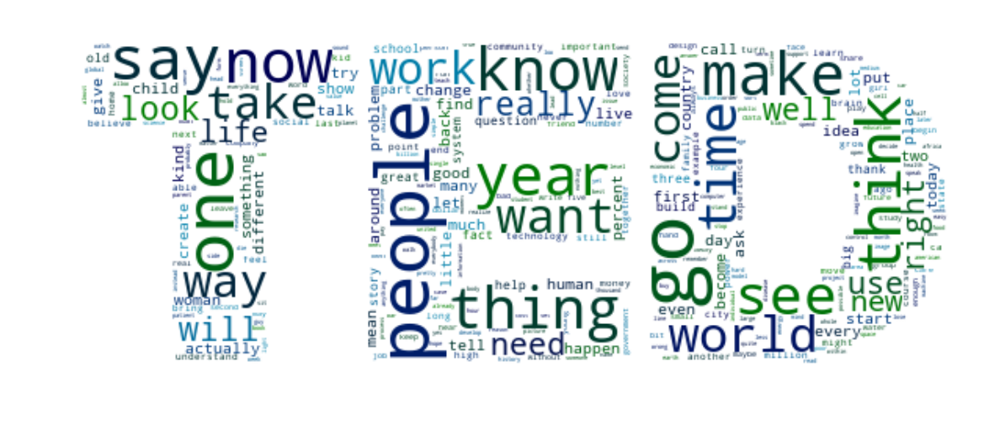

policy_politics_th


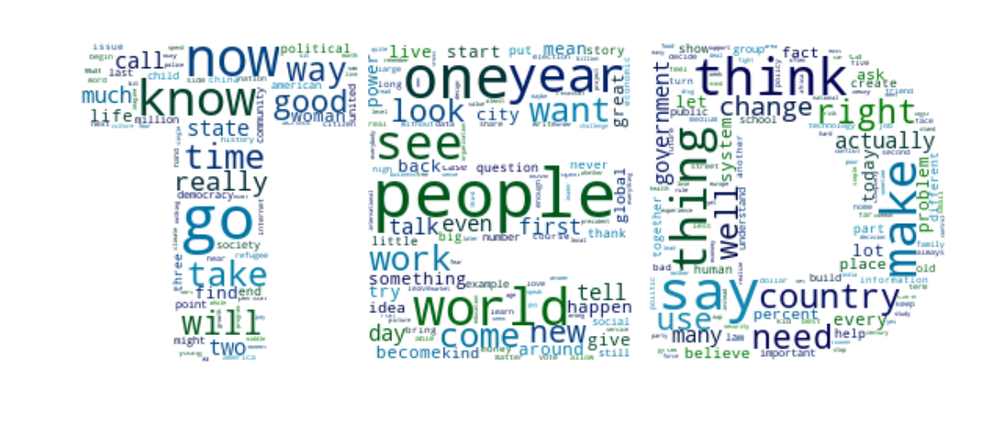

security_th


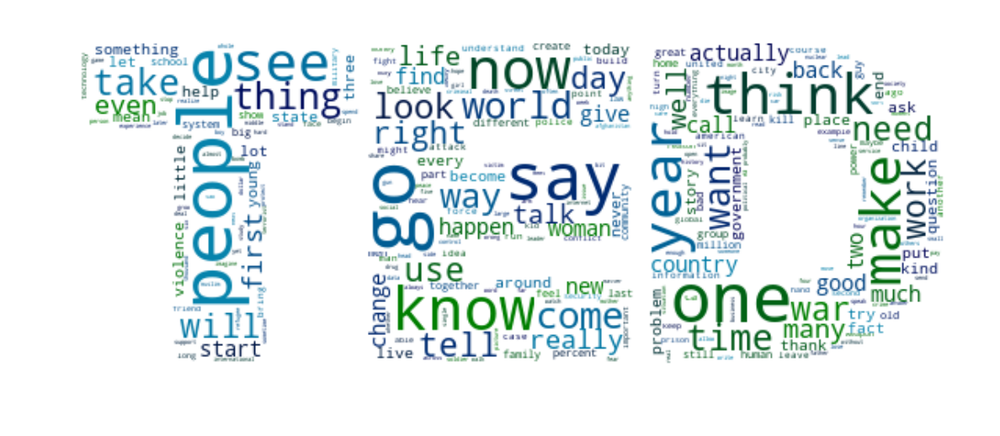

science_and_research_th


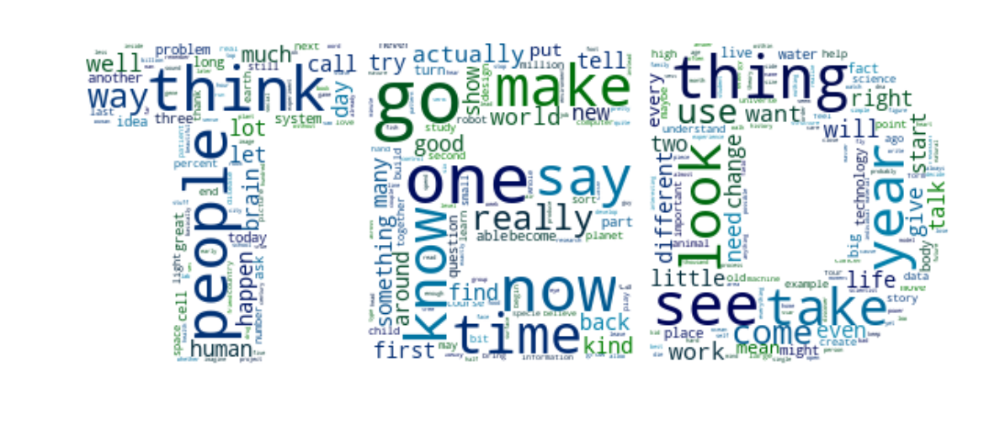

nature_environment_th


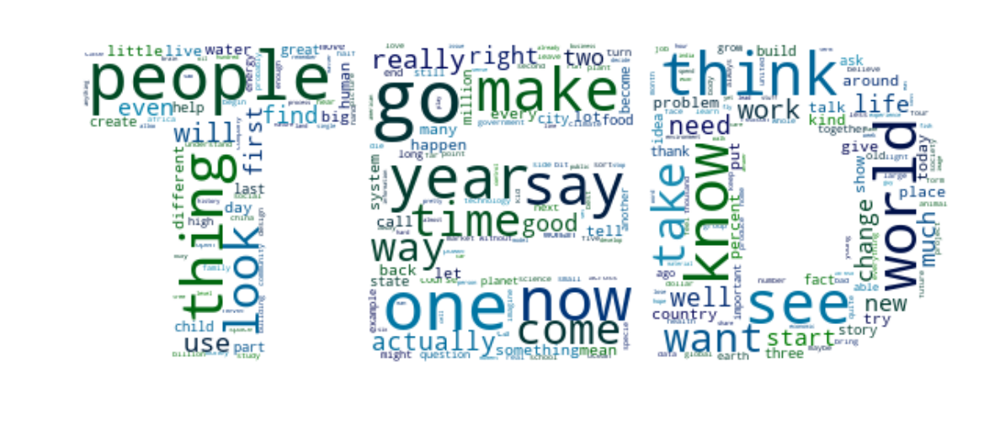

living_spaces_cult_th


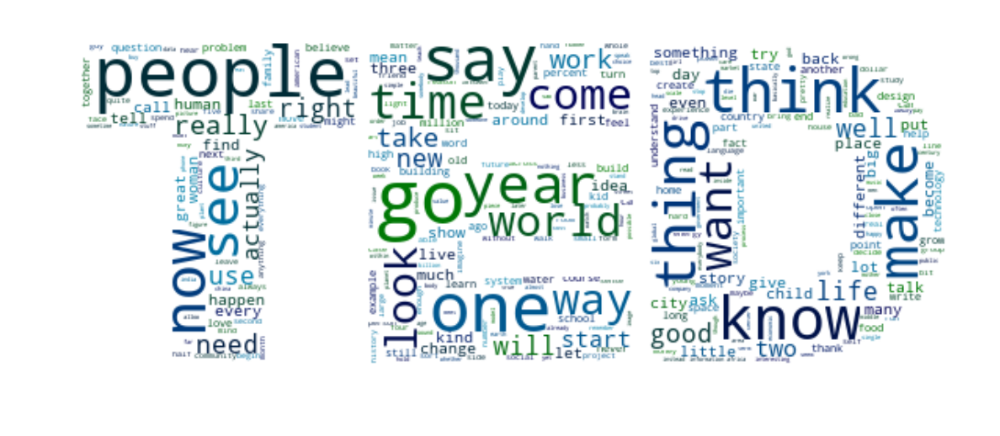

religions_spirituality_th


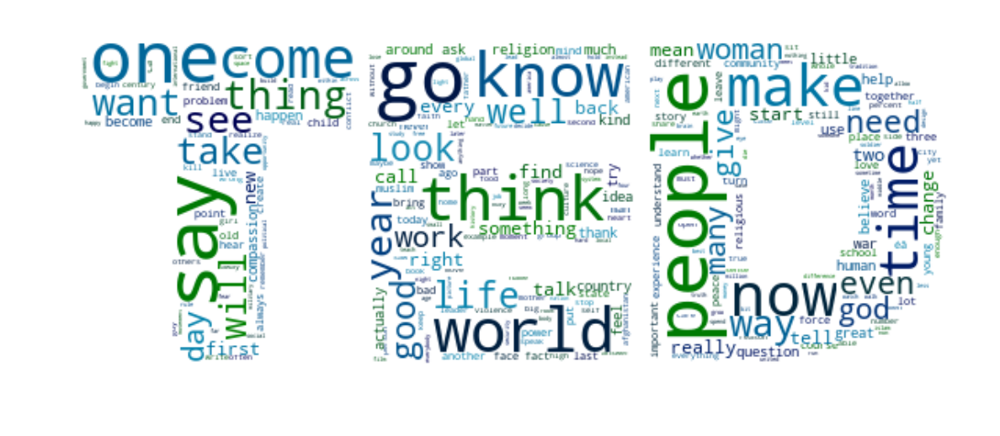

tedmem_awardwin_th


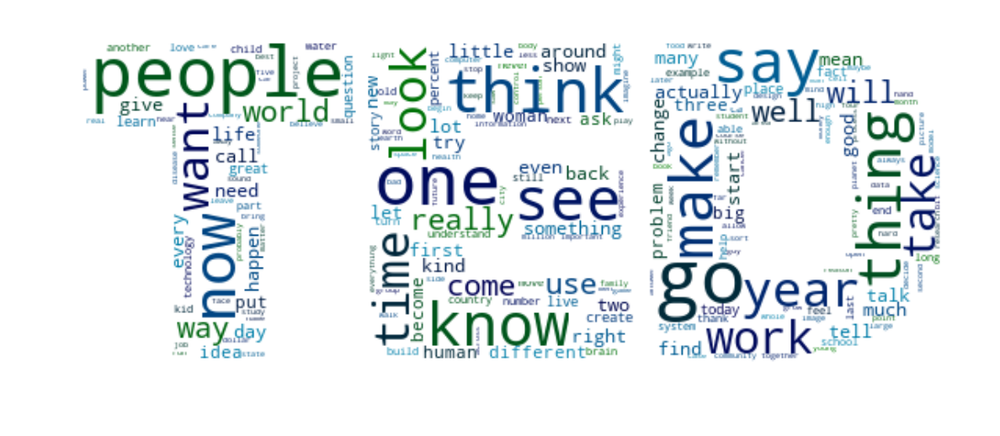

emotions_psychology_th


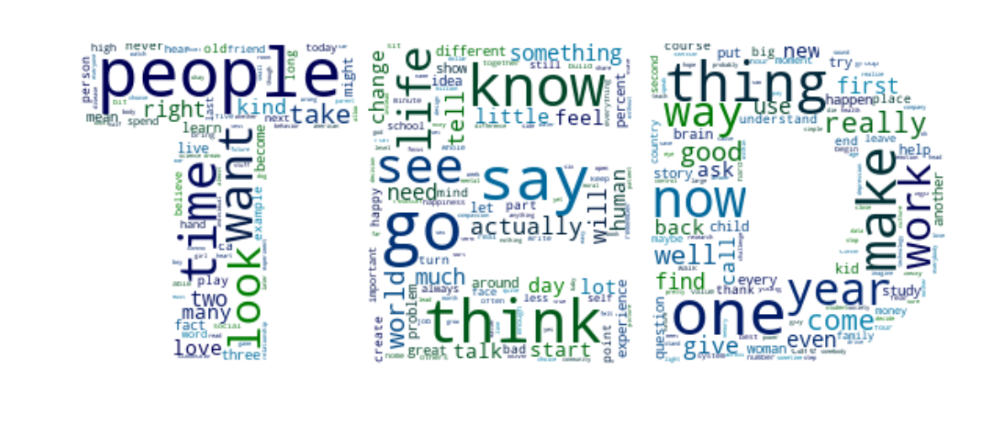

business_th


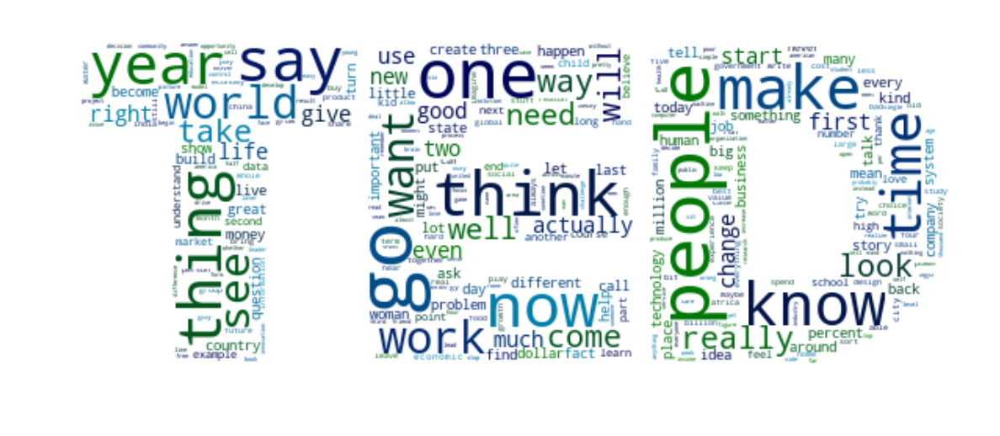

entertainment_th


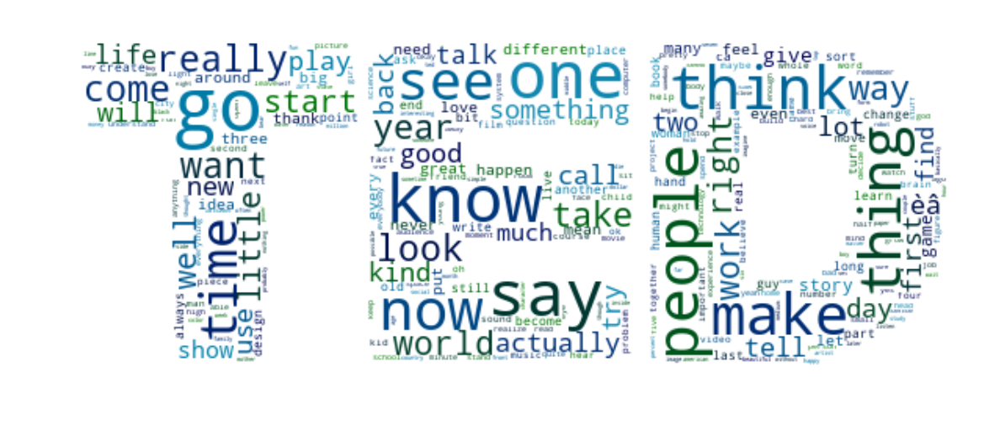

media_th


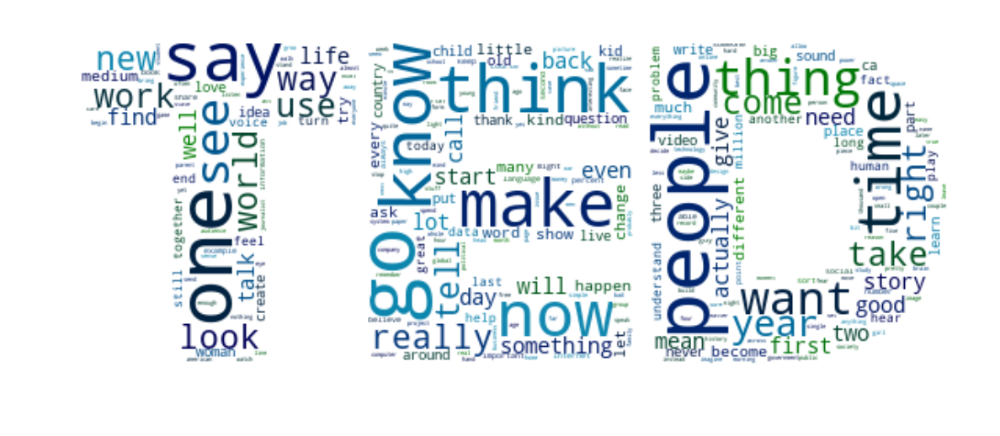

music_th


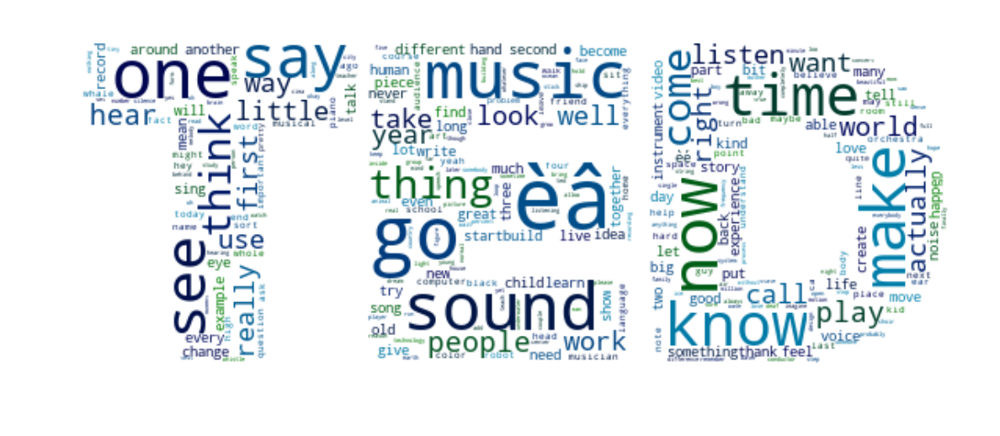

health_and_medicine_th


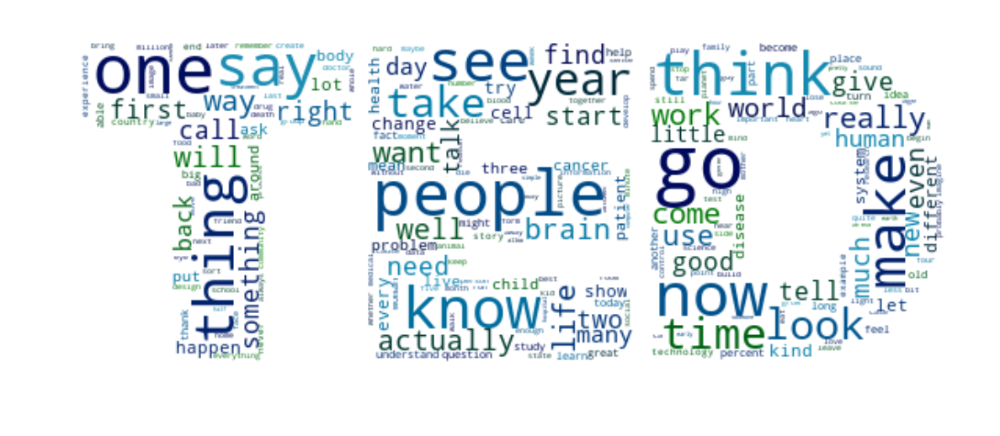

art_and_design_th


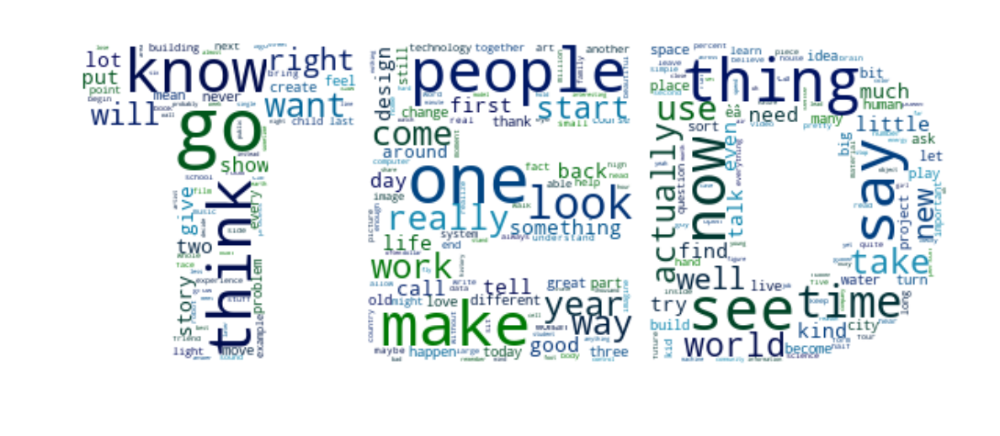

gender_matters_th


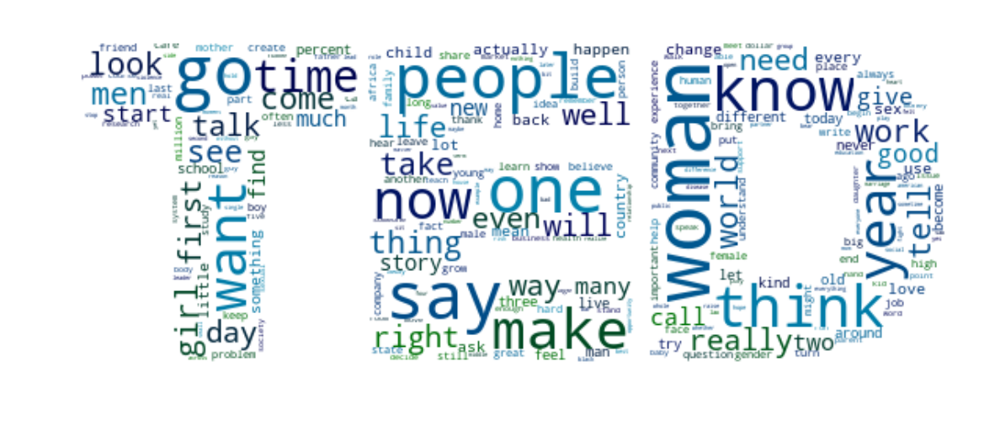

educ_learn_youth_th


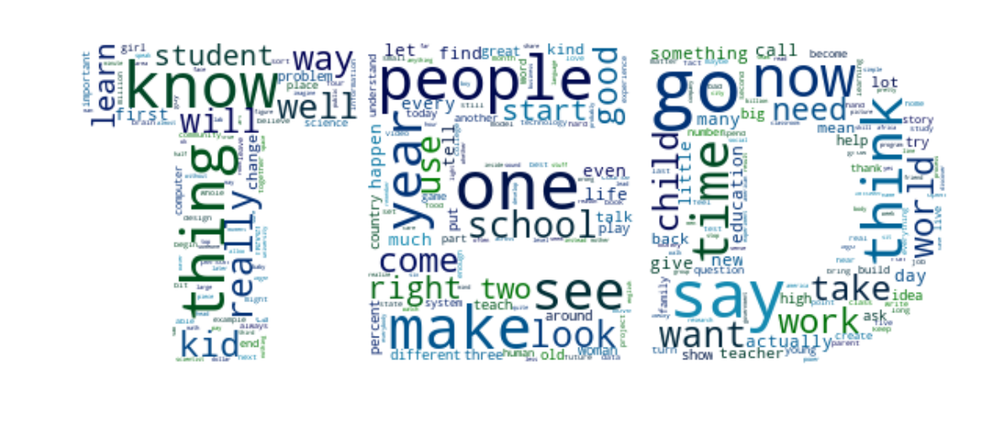

sports


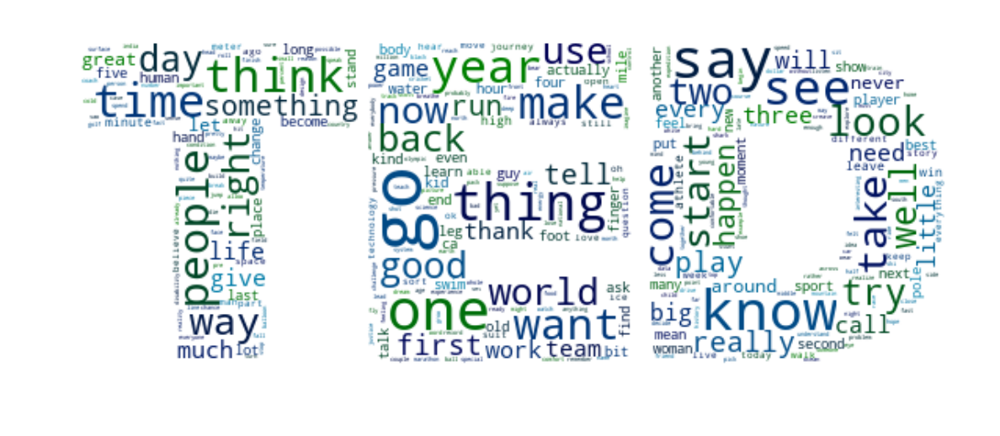

literature_th


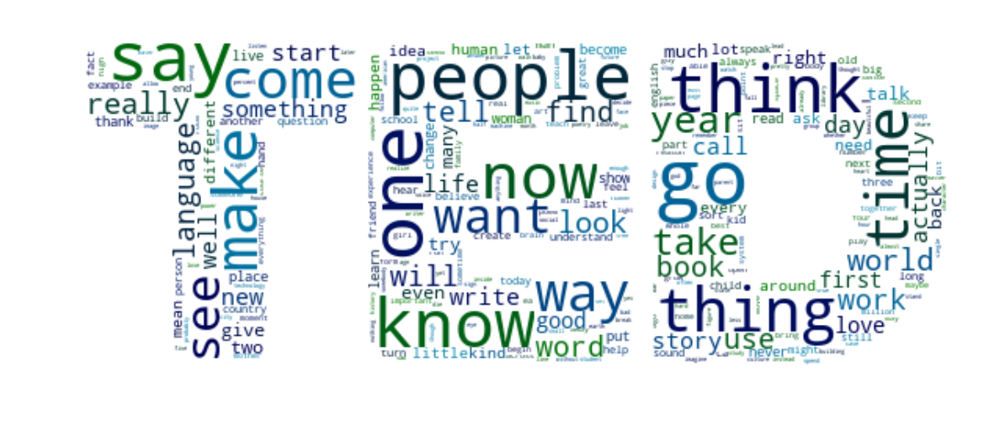

human_th


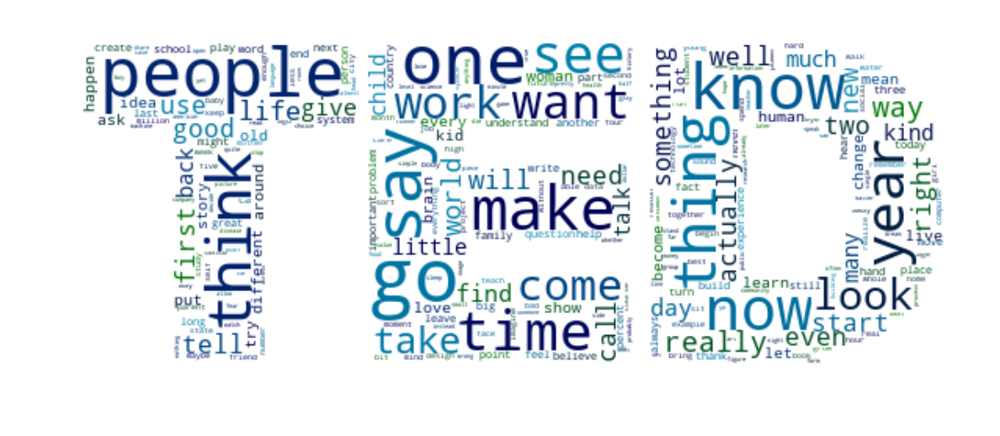

continents_cities_countries_th


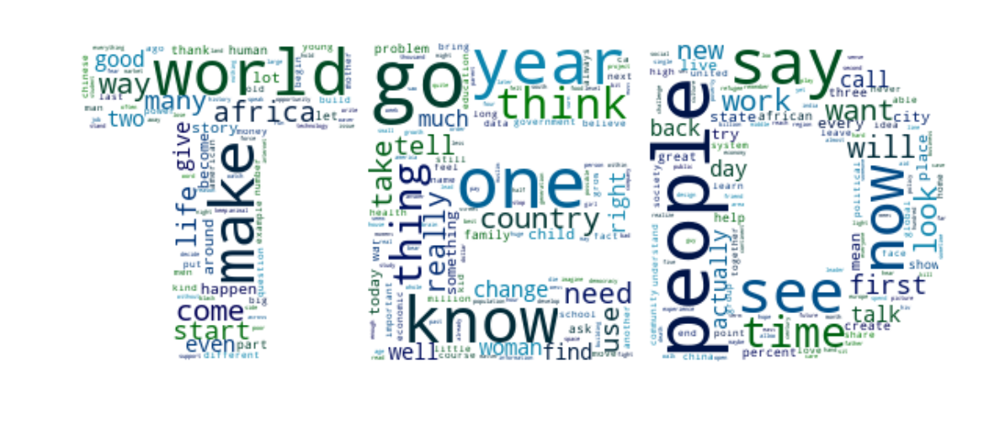

In [779]:
for i in list(df.columns)[139:161]:
    wc = WordCloud(background_color='white',
                   max_words=500,
                   mask=nhm_mask,
                   colormap=ocean_truncated,
                   collocations=False).generate(' '.join(df_try.lemmatized[df_try[i]==1]))

    #saving the resulting WordCloud image
    wc.to_file('ted_wordcloud_{}.png'.format(i))
    print(i)
    #displaying the WordCloud
    plt.figure(figsize=[10,10])
    plt.imshow(wc, interpolation='bilinear')
    plt.axis("off")
    plt.show()

## Multilabel Classification Using Video Transcripts

In [966]:
# creating the predictor matrix
X = df.transcript

In [967]:
# creating test and training sets
y = df[list(df.columns)[139:161]]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

In [30]:
len(list(df.columns)[139:161])

22

<b> Baseline Accuracy </b>

In [972]:
# mean of the y_train matrix
y_train.mean().mean()

0.19587071667927794

### KNN Classification

In [38]:
pipeline_knn = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('knn', OneVsRestClassifier(KNeighborsClassifier()))
                        ])

parameters_knn= {
'vect__max_features': (None, 1000),
    'vect__ngram_range':((1,1), (1,2)),
   'knn__estimator__n_neighbors':(9,12,15,25),
             'knn__estimator__weights':('uniform','distance'),

                }

In [ ]:
gr_rfcml = GridSearchCV(pipeline_knn, parameters_knn, cv=3, n_jobs=7, verbose=2)
gr_rfcml.fit(X_train, y_train)

In [44]:
gr_rfcml.best_estimator_.get_params()

{'extlem': ExtractLemmatized(column_choice='transcript'),
 'extlem__column_choice': 'transcript',
 'knn': OneVsRestClassifier(estimator=KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
            metric_params=None, n_jobs=1, n_neighbors=9, p=2,
            weights='uniform'),
           n_jobs=1),
 'knn__estimator': KNeighborsClassifier(algorithm='auto', leaf_size=30, metric='minkowski',
            metric_params=None, n_jobs=1, n_neighbors=9, p=2,
            weights='uniform'),
 'knn__estimator__algorithm': 'auto',
 'knn__estimator__leaf_size': 30,
 'knn__estimator__metric': 'minkowski',
 'knn__estimator__metric_params': None,
 'knn__estimator__n_jobs': 1,
 'knn__estimator__n_neighbors': 9,
 'knn__estimator__p': 2,
 'knn__estimator__weights': 'uniform',
 'knn__n_jobs': 1,
 'memory': None,
 'steps': [('extlem', ExtractLemmatized(column_choice='transcript')),
  ('vect',
   CountVectorizer(analyzer='word', binary=False, decode_error='strict',
           dtype=<

In [754]:
gr_rfcml.best_params_

{'knn__estimator__n_neighbors': 9,
 'knn__estimator__weights': 'uniform',
 'vect__max_features': 1000,
 'vect__ngram_range': (1, 2)}

In [824]:
# predictions
prediction = gr_rfcml.predict(X_test)

<b> Accuracy Score of the Model </b>

In [825]:
jaccard_similarity_score(y_test, prediction)

0.37119475916285904

<b> Baseline Precision </b>

In [87]:
# creating the baseline prediction matrix
y_baseline = y_train.copy()
for col in y_baseline.columns:
    if y_baseline[col].mean()>0.5:
        y_baseline[col] = 1
    else:
        y_baseline[col] = 0

In [90]:
y_baseline.head(4)

,technology_th,society_th,policy_politics_th,security_th,science_and_research_th,nature_environment_th,living_spaces_cult_th,religions_spirituality_th,tedmem_awardwin_th,emotions_psychology_th,business_th,entertainment_th,media_th,music_th,health_and_medicine_th,art_and_design_th,gender_matters_th,educ_learn_youth_th,sports,literature_th,human_th,continents_cities_countries_th
458,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
78,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1103,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
32,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [973]:
average_precision_score(y_train,y_baseline,average="micro")

0.1958707166792779

<b> Model Average Precision Score </b>

In [ ]:
# predictios
predictions = gr_rfcml.best_estimator_.predict(X_test)
pred_prb = gr_rfcml.best_estimator_.predict_proba(X_test)      

In [814]:
#  A "micro-average": quantifying score on all classes jointly
precision["micro"], recall["micro"], _ = precision_recall_curve(np.array(y_test).ravel(),
    pred_prb.ravel())
average_precision["micro"] = average_precision_score(y_test, predictions,
                                                     average="micro")
print('Average precision score, micro-averaged over all classes: {0:0.2f}'
      .format(average_precision["micro"]))

Average precision score, micro-averaged over all classes: 0.39


<b> Baseline Accuracy for Each Label </b>

In [848]:
dict_base = {}
for i in range(len(y.columns)):
    col_true = y_test.iloc[:,i]
    col_pred = prediction[:,i]
    dict_base[y_test.columns[i]]= y_train.iloc[:,i].mean()
    dict_pd[y_test.columns[i]] = accuracy_score(col_true, col_pred)
col_acc = pd.Series(dict_pd)
col_base = pd.Series(dict_base)

In [850]:
col_base

art_and_design_th                 0.351367
business_th                       0.247919
continents_cities_countries_th    0.103448
educ_learn_youth_th               0.097503
emotions_psychology_th            0.124257
entertainment_th                  0.144471
gender_matters_th                 0.068966
health_and_medicine_th            0.258026
human_th                          0.313317
literature_th                     0.082640
living_spaces_cult_th             0.294887
media_th                          0.077289
music_th                          0.024376
nature_environment_th             0.383472
policy_politics_th                0.102854
religions_spirituality_th         0.048751
science_and_research_th           0.374554
security_th                       0.088585
society_th                        0.353151
sports                            0.015458
technology_th                     0.480975
tedmem_awardwin_th                0.272889
dtype: float64

<b> Model Accuracy for Each Label </b>

In [852]:
col_acc

art_and_design_th                 0.785021
business_th                       0.822469
continents_cities_countries_th    0.897365
educ_learn_youth_th               0.898752
emotions_psychology_th            0.901526
entertainment_th                  0.886269
gender_matters_th                 0.955617
health_and_medicine_th            0.819695
human_th                          0.719834
literature_th                     0.938974
living_spaces_cult_th             0.744799
media_th                          0.925104
music_th                          0.980583
nature_environment_th             0.753121
policy_politics_th                0.918169
religions_spirituality_th         0.955617
science_and_research_th           0.757282
security_th                       0.918169
society_th                        0.643551
sports                            0.988904
technology_th                     0.679612
tedmem_awardwin_th                0.721221
dtype: float64

#### Precision-Recall Curves for Each Label

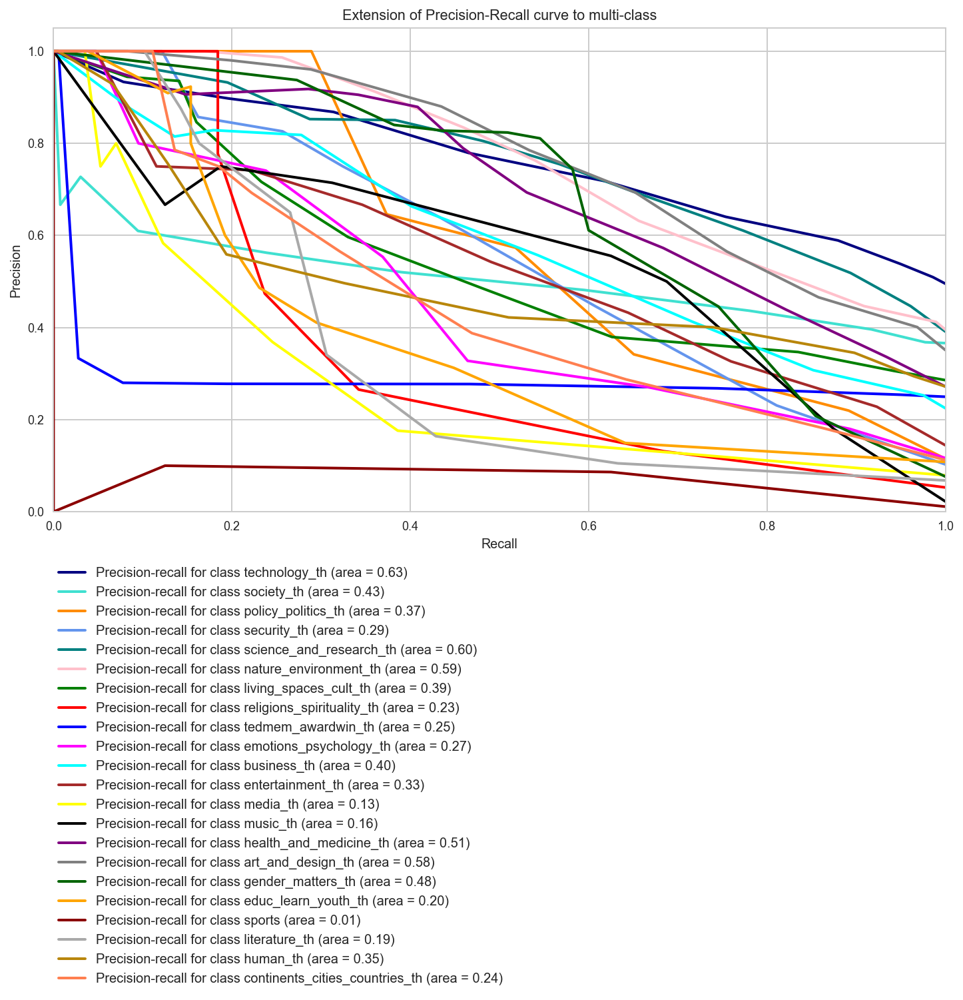

In [970]:
from itertools import cycle
colors = cycle(['navy', 'turquoise', 'darkorange', 'cornflowerblue', 'teal', 'pink', 'green', 'red', 'blue', 'magenta',
               'cyan', 'brown', 'yellow', 'black', 'purple', 'grey', 'darkgreen', 'orange', 'darkred', 'darkgrey', 'darkgoldenrod',
               'coral'])
lines = []
labels = []
sns.set(style="whitegrid", color_codes=True, font_scale=0.9)
plt.figure(figsize=(12, 8))

for i, color in zip(range(len(precision.keys())-1), colors):
    l, = plt.plot(recall[i], precision[i], color=color, lw=2)
    lines.append(l)
    labels.append('Precision-recall for class {0} (area = {1:0.2f})'.format(y.columns[i], average_precision[i]))
    
fig = plt.gcf()
fig.subplots_adjust(bottom=0.25)
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.title('Extension of Precision-Recall curve to multi-class')
plt.legend(lines, labels, loc=(0, -.99), prop=dict(size=10));


### Extra Trees Classifier

In [165]:
pipeline_et = Pipeline([('extlem', ExtractLemmatized(column_choice='transcript')),
    ('vect', CountVectorizer(stop_words='english')),
                      ('tfidf', TfidfTransformer()),
                       ('et', OneVsRestClassifier(ExtraTreesClassifier()))
                        ])

parameters_et= {
'vect__max_features': (500, 1000),
    'vect__ngram_range':((1,1), (1,2)),
                "et__estimator__max_depth": (15, 30),
              "et__estimator__max_features": ('sqrt', 'log2', None, 0.2, 0.5),
# #               "rfcml__estimator__bootstrap": (True, False),
# #               "rfcml__estimator__criterion": ("gini", "entropy")
                }

In [166]:
gr_et = GridSearchCV(pipeline_et, parameters_et, cv=3, verbose=2, n_jobs=8)

In [ ]:
gr_et.fit(X_train, y_train)

In [168]:
pred = gr_et.predict(X_test)

In [ ]:
gr_et.best_estimator_

In [170]:
jaccard_similarity_score(y_test, pred)

0.32271216224059496

### Results of the Multi Label Topic Classification Models

In order to correctly classify the 